## MiRNA_Training 

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [2]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GCNConv, GATConv
from torch_geometric.data import Data
from sklearn.metrics.pairwise import rbf_kernel
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.decomposition import PCA
import optuna
import random
import json
import os

In [3]:
# Set random seed for reproducibility
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)

In [4]:
# Device configuration
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

In [5]:
def load_data(file_path):
    """C:/Users/Basharat Ahmad/Desktop/Final dataset Five fold CV/alldata.xlsx."""
    try:
        data = pd.read_excel(file_path)
        return data
    except Exception as e:
        print(f"Error loading data: {e}")
        return None

In [6]:
def preprocess_data(data):
    """Preprocess data into an association matrix."""
    associations = data[['miRNA', 'disease']].drop_duplicates()
    miRNAs = associations['miRNA'].unique()
    diseases = associations['disease'].unique()
    matrix = pd.DataFrame(0, index=miRNAs, columns=diseases)
    matrix.index.name = 'miRNA'
    matrix.columns.name = 'disease'
    for _, row in associations.iterrows():
        if row['miRNA'] in matrix.index and row['disease'] in matrix.columns:
            matrix.loc[row['miRNA'], row['disease']] = 1
    return matrix, miRNAs, diseases

In [7]:
def compute_similarity(matrix):
    """Compute Gaussian Interaction Profile Kernel (GIPK) similarity matrices."""
    gamma_m = 1.0 / (matrix.sum(axis=1).mean() + 1e-10)
    miRNA_sim = pd.DataFrame(rbf_kernel(matrix, gamma=gamma_m), index=matrix.index, columns=matrix.index)
    gamma_d = 1.0 / (matrix.sum(axis=0).mean() + 1e-10)
    disease_sim = pd.DataFrame(rbf_kernel(matrix.T, gamma=gamma_d), index=matrix.columns, columns=matrix.columns)
    return miRNA_sim, disease_sim

In [8]:
def prepare_gcn_data(matrix, miRNA_sim, disease_sim, feature_dim=16):
    """Prepare PyTorch Geometric Data object with node features and edge index."""
    miRNAs = matrix.index
    diseases = matrix.columns
    n_mirnas = len(miRNAs)
    n_diseases = len(diseases)
    pca_m = PCA(n_components=feature_dim, random_state=42)
    miRNA_features = pca_m.fit_transform(miRNA_sim)
    pca_d = PCA(n_components=feature_dim, random_state=42)
    disease_features = pca_d.fit_transform(disease_sim)
    x = torch.tensor(np.vstack([miRNA_features, disease_features]), dtype=torch.float).to(device)
    edges = matrix.stack().reset_index()
    edges = edges[edges[0] == 1]
    miRNA_indices = edges['miRNA'].apply(lambda x: list(miRNAs).index(x)).values
    disease_indices = edges['disease'].apply(lambda x: list(diseases).index(x) + n_mirnas).values
    edge_index = torch.tensor(np.array([miRNA_indices, disease_indices]), dtype=torch.long).to(device)
    edge_index = torch.cat([edge_index, edge_index[[1, 0]]], dim=1)
    return Data(x=x, edge_index=edge_index).to(device), n_mirnas, n_diseases

In [9]:
class MDMF(nn.Module):
    def __init__(self, num_mirnas, num_diseases, latent_dim, lambda_reg):
        super(MDMF, self).__init__()
        torch.manual_seed(42)  # Ensure deterministic initialization
        self.U = nn.Parameter(torch.randn(num_mirnas, latent_dim))
        self.V = nn.Parameter(torch.randn(num_diseases, latent_dim))
        self.lambda_reg = lambda_reg

    def forward(self, A, S_m, S_d):
        recon_loss = F.mse_loss(torch.mm(self.U, self.V.t()), A)
        reg_U = torch.norm(self.U, p=2)
        reg_V = torch.norm(self.V, p=2)
        reg_S_m = torch.norm(torch.mm(self.U, self.U.t()) - S_m, p=2)
        reg_S_d = torch.norm(torch.mm(self.V, self.V.t()) - S_d, p=2)
        loss = recon_loss + self.lambda_reg * (reg_U + reg_V + reg_S_m + reg_S_d)
        return loss

    def get_features(self):
        return self.U, self.V

In [10]:
class HybridGCN_GAT(nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels, dropout, num_heads, num_layers=3):
        super(HybridGCN_GAT, self).__init__()
        self.num_layers = num_layers
        self.dropout = dropout
        self.gcn_layers = nn.ModuleList()
        self.gcn_layers.append(GCNConv(in_channels, hidden_channels))
        for _ in range(num_layers - 2):
            self.gcn_layers.append(GCNConv(hidden_channels, hidden_channels))
        self.gcn_layers.append(GCNConv(hidden_channels, out_channels))
        self.gat_layers = nn.ModuleList()
        self.gat_layers.append(GATConv(in_channels, hidden_channels, heads=num_heads, concat=False))
        for _ in range(num_layers - 2):
            self.gat_layers.append(GATConv(hidden_channels, hidden_channels, heads=num_heads, concat=False))
        self.gat_layers.append(GATConv(hidden_channels, out_channels, heads=num_heads, concat=False))
        self.gcn_residual = nn.Linear(in_channels, out_channels) if in_channels != out_channels else nn.Identity()
        self.gat_residual = nn.Linear(in_channels, out_channels) if in_channels != out_channels else nn.Identity()

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x_gcn = x
        for i, layer in enumerate(self.gcn_layers):
            x_gcn = layer(x_gcn, edge_index)
            if i < self.num_layers - 1:
                x_gcn = x_gcn.relu()
                x_gcn = F.dropout(x_gcn, p=self.dropout, training=self.training)
        x_gcn += self.gcn_residual(x)
        x_gat = x
        for i, layer in enumerate(self.gat_layers):
            x_gat = layer(x_gat, edge_index)
            if i < self.num_layers - 1:
                x_gat = x_gat.relu()
                x_gat = F.dropout(x_gat, p=self.dropout, training=self.training)
        x_gat += self.gat_residual(x)
        x_combined = torch.cat([x_gcn, x_gat], dim=1)
        return x_combined

In [11]:
def train_model(model, data, train_mask, train_labels, optimizer, criterion):
    model.train()
    optimizer.zero_grad()
    out = model(data)
    mirna_emb, disease_emb = out[:data.n_mirnas], out[data.n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    loss = criterion(pred[train_mask], train_labels)
    loss.backward()
    optimizer.step()
    return loss.item()

In [12]:
def evaluate_model(model, data, mask, labels):
    model.eval()
    with torch.no_grad():
        out = model(data)
        mirna_emb, disease_emb = out[:data.n_mirnas], out[data.n_mirnas:]
        pred = (mirna_emb @ disease_emb.t()).view(-1)
        pred_scores = torch.sigmoid(pred[mask]).cpu().numpy()
        auc = roc_auc_score(labels.cpu().numpy(), pred_scores)
    return auc

In [13]:
def train_mdmf(mdmf, A, S_m, S_d, epochs=100, lr=0.01):
    torch.manual_seed(42)  # Ensure deterministic initialization
    optimizer = torch.optim.Adam(mdmf.parameters(), lr=lr)
    mdmf.to(device)
    A, S_m, S_d = A.to(device), S_m.to(device), S_d.to(device)
    for epoch in range(epochs):
        optimizer.zero_grad()
        loss = mdmf(A, S_m, S_d)
        loss.backward()
        optimizer.step()
    return mdmf.get_features()

In [14]:
def objective(trial, matrix, miRNAs, diseases, train_mask, train_labels, val_mask, val_labels):
    hidden_dim = trial.suggest_int('hidden_dim', 64, 256)
    learning_rate = trial.suggest_float('learning_rate', 1e-5, 1e-2, log=True)
    dropout = trial.suggest_float('dropout', 0.1, 0.5)
    num_heads = trial.suggest_int('num_heads', 1, 16)
    num_layers = trial.suggest_int('num_layers', 2, 4)
    pca_dim = trial.suggest_categorical('pca_dim', [16, 32, 64])
    latent_dim = trial.suggest_int('latent_dim', 16, 64)
    out_channels = trial.suggest_int('out_channels', 8, 64)
    lambda_reg = trial.suggest_float('lambda_reg', 0.01, 0.1, log=True)
    weight_decay = trial.suggest_float('weight_decay', 1e-5, 1e-3, log=True)

    miRNA_sim, disease_sim = compute_similarity(matrix)
    gcn_data_new, n_mirnas, n_diseases = prepare_gcn_data(matrix, miRNA_sim, disease_sim, feature_dim=pca_dim)
    gcn_data_new.n_mirnas = n_mirnas

    mdmf = MDMF(num_mirnas=len(miRNAs), num_diseases=len(diseases), latent_dim=latent_dim, lambda_reg=lambda_reg)
    U, V = train_mdmf(mdmf, torch.tensor(matrix.values, dtype=torch.float),
                      torch.tensor(miRNA_sim.values, dtype=torch.float),
                      torch.tensor(disease_sim.values, dtype=torch.float))

    mdmf_features = torch.cat([U, V], dim=0).to(device)
    gcn_data_new.x = torch.cat([gcn_data_new.x, mdmf_features], dim=1)

    model = HybridGCN_GAT(in_channels=gcn_data_new.x.shape[1], hidden_channels=hidden_dim,
                          out_channels=out_channels, dropout=dropout, num_heads=num_heads, num_layers=num_layers)
    model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
    criterion = nn.BCEWithLogitsLoss()

    max_epochs = 200
    patience = 10
    best_val_auc = 0
    counter = 0

    for epoch in range(max_epochs):
        train_loss = train_model(model, gcn_data_new, train_mask, train_labels.to(device), optimizer, criterion)
        val_auc = evaluate_model(model, gcn_data_new, val_mask, val_labels.to(device))
        if val_auc > best_val_auc:
            best_val_auc = val_auc
            counter = 0
        else:
            counter += 1
            if counter >= patience:
                print(f"Early stopping at epoch {epoch}")
                break

    return best_val_auc

In [15]:
file_path = 'C:/Users/Basharat Ahmad/Desktop/Final dataset Five fold CV/alldata.xlsx'
data = load_data(file_path)

In [16]:
matrix, miRNAs, diseases = preprocess_data(data)

In [17]:
# Split positive pairs
known_pairs = matrix.stack().reset_index()
known_pairs = known_pairs[known_pairs[0] == 1]
train_val_pairs, test_pairs = train_test_split(known_pairs, test_size=0.15, random_state=42)
train_pairs, val_pairs = train_test_split(train_val_pairs, test_size=0.15/0.85, random_state=42)

train_positive_flats = np.array([matrix.index.get_loc(m) * len(diseases) + matrix.columns.get_loc(d) 
                                    for m, d in zip(train_pairs['miRNA'], train_pairs['disease'])])
val_positive_flats = np.array([matrix.index.get_loc(m) * len(diseases) + matrix.columns.get_loc(d) 
                                for m, d in zip(val_pairs['miRNA'], val_pairs['disease'])])
test_positive_flats = np.array([matrix.index.get_loc(m) * len(diseases) + matrix.columns.get_loc(d) 
                                for m, d in zip(test_pairs['miRNA'], test_pairs['disease'])])

flat_matrix = matrix.values.flatten()
negative_flats = np.where(flat_matrix == 0)[0]

train_negative_flats = np.random.choice(negative_flats, size=len(train_positive_flats), replace=False)
remaining_negative_flats = np.setdiff1d(negative_flats, train_negative_flats)
val_negative_flats = np.random.choice(remaining_negative_flats, size=len(val_positive_flats), replace=False)
remaining_negative_flats = np.setdiff1d(remaining_negative_flats, val_negative_flats)
test_negative_flats = np.random.choice(remaining_negative_flats, size=len(test_positive_flats), replace=False)


In [18]:
train_mask = np.concatenate([train_positive_flats, train_negative_flats])
train_labels = torch.tensor(np.concatenate([np.ones(len(train_positive_flats)), np.zeros(len(train_negative_flats))]), 
                            dtype=torch.float).to(device)

val_mask = np.concatenate([val_positive_flats, val_negative_flats])
val_labels = torch.tensor(np.concatenate([np.ones(len(val_positive_flats)), np.zeros(len(val_negative_flats))]), 
                            dtype=torch.float).to(device)

test_mask = np.concatenate([test_positive_flats, test_negative_flats])
test_labels = torch.tensor(np.concatenate([np.ones(len(test_positive_flats)), np.zeros(len(test_negative_flats))]), 
                            dtype=torch.float).to(device)

train_val_mask = np.concatenate([train_mask, val_mask])
train_val_labels = torch.tensor(np.concatenate([train_labels.cpu().numpy(), val_labels.cpu().numpy()]), 
                                dtype=torch.float).to(device)


In [ ]:
# miRNA_sim, disease_sim = compute_similarity(matrix)
# gcn_data, n_mirnas, n_diseases = prepare_gcn_data(matrix, miRNA_sim, disease_sim)
# gcn_data.n_mirnas = n_mirnas

# Optuna tuning
study = optuna.create_study(direction='maximize')
study.optimize(lambda trial: objective(trial, matrix, miRNAs, diseases, train_mask, train_labels, val_mask, val_labels), 
                n_trials=100)

print(f"Best hyperparameters: {study.best_params}")
print(f"Best validation AUC: {study.best_value:.4f}")

# Save best hyperparameters
with open('best_params.json', 'w') as f:
    json.dump(study.best_params, f)

[I 2025-11-11 19:57:49,523] A new study created in memory with name: no-name-0ff74638-ae51-43ee-99e7-0d1e391e6372
[I 2025-11-11 19:58:10,801] Trial 0 finished with value: 0.8938649180803719 and parameters: {'hidden_dim': 167, 'learning_rate': 0.00167534985303601, 'dropout': 0.43051690897621353, 'num_heads': 1, 'num_layers': 3, 'pca_dim': 64, 'latent_dim': 63, 'out_channels': 15, 'lambda_reg': 0.011139837545109759, 'weight_decay': 4.870939152911712e-05}. Best is trial 0 with value: 0.8938649180803719.


Early stopping at epoch 14


[I 2025-11-11 19:58:45,764] Trial 1 finished with value: 0.7178522832744643 and parameters: {'hidden_dim': 210, 'learning_rate': 0.00020535404369692982, 'dropout': 0.24180495240956237, 'num_heads': 5, 'num_layers': 4, 'pca_dim': 32, 'latent_dim': 41, 'out_channels': 50, 'lambda_reg': 0.01811743737428661, 'weight_decay': 0.000554837287960337}. Best is trial 0 with value: 0.8938649180803719.


Early stopping at epoch 10


[I 2025-11-11 20:00:10,885] Trial 2 finished with value: 0.9056702735255587 and parameters: {'hidden_dim': 102, 'learning_rate': 0.0018564301405273212, 'dropout': 0.26027343910800504, 'num_heads': 8, 'num_layers': 4, 'pca_dim': 32, 'latent_dim': 62, 'out_channels': 59, 'lambda_reg': 0.03455198419885899, 'weight_decay': 3.207967341764565e-05}. Best is trial 2 with value: 0.9056702735255587.


Early stopping at epoch 45


[I 2025-11-11 20:00:39,905] Trial 3 finished with value: 0.9055592894522559 and parameters: {'hidden_dim': 231, 'learning_rate': 0.004032586554170137, 'dropout': 0.22169113040666893, 'num_heads': 7, 'num_layers': 2, 'pca_dim': 32, 'latent_dim': 47, 'out_channels': 16, 'lambda_reg': 0.023043326424865142, 'weight_decay': 3.10984104519019e-05}. Best is trial 2 with value: 0.9056702735255587.


Early stopping at epoch 15


[I 2025-11-11 20:01:12,608] Trial 4 finished with value: 0.9262992781746755 and parameters: {'hidden_dim': 253, 'learning_rate': 0.0069930412737184994, 'dropout': 0.4789165319727764, 'num_heads': 4, 'num_layers': 4, 'pca_dim': 64, 'latent_dim': 17, 'out_channels': 10, 'lambda_reg': 0.04208042501985015, 'weight_decay': 2.4305528018211974e-05}. Best is trial 4 with value: 0.9262992781746755.


Early stopping at epoch 10


[I 2025-11-11 20:01:41,516] Trial 5 finished with value: 0.9004408872061879 and parameters: {'hidden_dim': 82, 'learning_rate': 0.006341570947090435, 'dropout': 0.355223504737178, 'num_heads': 2, 'num_layers': 4, 'pca_dim': 16, 'latent_dim': 30, 'out_channels': 59, 'lambda_reg': 0.03406703467854739, 'weight_decay': 0.0005164915252497489}. Best is trial 4 with value: 0.9262992781746755.


Early stopping at epoch 25


[I 2025-11-11 20:03:43,453] Trial 6 finished with value: 0.7646950838882873 and parameters: {'hidden_dim': 210, 'learning_rate': 2.084669387733244e-05, 'dropout': 0.3301494816186732, 'num_heads': 3, 'num_layers': 2, 'pca_dim': 64, 'latent_dim': 26, 'out_channels': 57, 'lambda_reg': 0.01704835279751465, 'weight_decay': 0.00011591259191622239}. Best is trial 4 with value: 0.9262992781746755.
[I 2025-11-11 20:06:40,951] Trial 7 finished with value: 0.9074689429830158 and parameters: {'hidden_dim': 209, 'learning_rate': 0.0014645989274224363, 'dropout': 0.21107534532481886, 'num_heads': 12, 'num_layers': 4, 'pca_dim': 16, 'latent_dim': 52, 'out_channels': 21, 'lambda_reg': 0.049798840248273, 'weight_decay': 4.908374662717852e-05}. Best is trial 4 with value: 0.9262992781746755.


Early stopping at epoch 42


In [23]:
best_params = study.best_params
best_pca_dim = best_params['pca_dim']
best_latent_dim = best_params['latent_dim']
best_lambda_reg = best_params['lambda_reg']
best_hidden_dim = best_params['hidden_dim']
best_out_channels = best_params['out_channels']
best_dropout = best_params['dropout']
best_num_heads = best_params['num_heads']
best_num_layers = best_params['num_layers']
best_learning_rate = best_params['learning_rate']
best_weight_decay = best_params['weight_decay']

In [24]:
def train_final_model(model, data, best_learning_rate, best_weight_decay, train_val_mask, train_val_labels, test_mask, test_labels, model_saved_name, max_epochs=200, patience=20):
    model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=best_learning_rate, weight_decay=best_weight_decay)
    criterion = nn.BCEWithLogitsLoss()
    
    best_val_auc = 0
    patience_counter = 0
    best_model_state = None
    train_losses = []
    val_aucs = []

    for epoch in range(max_epochs):
        train_loss = train_model(model, data, train_val_mask, train_val_labels.to(device), optimizer, criterion)
        val_auc = evaluate_model(model, data, test_mask, test_labels.to(device))

        train_losses.append(train_loss)
        val_aucs.append(val_auc)
        
        if val_auc > best_val_auc:
            best_val_auc = val_auc
            best_model_state = model.state_dict()
            patience_counter = 0
        else:
            patience_counter += 1
        
        if patience_counter >= patience:
            print(f"Early stopping at epoch {epoch+1}")
            break
        
        if epoch % 10 == 0:
            print(f"Epoch {epoch+1}/{max_epochs}, Train Loss: {train_loss:.4f}, Val AUC: {val_auc:.4f}")

    model.load_state_dict(best_model_state)
    os.makedirs('models', exist_ok=True)

    torch.save(best_model_state, f'models/{model_saved_name}')
    print(f"Best model saved to models/{model_saved_name}")
    test_auc = evaluate_model(model, data, test_mask, test_labels.to(device))

    return test_auc, train_losses, val_aucs

In [25]:
# Prepare final data
miRNA_sim, disease_sim = compute_similarity(matrix)
gcn_data_final, n_mirnas, n_diseases = prepare_gcn_data(matrix, miRNA_sim, disease_sim, feature_dim=best_pca_dim)
gcn_data_final.n_mirnas = n_mirnas

# Train MDMF with best parameters
mdmf_final = MDMF(num_mirnas=len(miRNAs), num_diseases=len(diseases), latent_dim=best_latent_dim, 
                    lambda_reg=best_lambda_reg)
U_final, V_final = train_mdmf(mdmf_final, torch.tensor(matrix.values, dtype=torch.float),
                                torch.tensor(miRNA_sim.values, dtype=torch.float),
                                torch.tensor(disease_sim.values, dtype=torch.float))


In [26]:
# Save MDMF features
# os.makedirs('models', exist_ok=True)
# torch.save({'U': U_final, 'V': V_final}, 'models/mdmf_features.pth')

mdmf_features_final = torch.cat([U_final, V_final], dim=0).to(device)
gcn_data_final.x = torch.cat([gcn_data_final.x, mdmf_features_final], dim=1)

In [27]:
# Define final model
model_final = HybridGCN_GAT(in_channels=gcn_data_final.x.shape[1], hidden_channels=best_hidden_dim,
                            out_channels=best_out_channels, dropout=best_dropout, 
                            num_heads=best_num_heads, num_layers=best_num_layers)

epochs = 200
patience = 20
model_saved_name = "model_final11.pth"
 
# Train final model and get initial test AUC
test_auc, train_losses, val_aucs = train_final_model(model_final, gcn_data_final, best_learning_rate, best_weight_decay, train_val_mask, train_val_labels, 
                                test_mask, test_labels, model_saved_name,  max_epochs=epochs, patience=patience)
print(f"Initial Test AUC: {test_auc:.4f}")

Epoch 1/200, Train Loss: 9.1386, Val AUC: 0.8457
Epoch 11/200, Train Loss: 1.0209, Val AUC: 0.8958
Epoch 21/200, Train Loss: 0.5130, Val AUC: 0.8991
Epoch 31/200, Train Loss: 0.4655, Val AUC: 0.9122
Epoch 41/200, Train Loss: 0.4054, Val AUC: 0.9247
Epoch 51/200, Train Loss: 0.3025, Val AUC: 0.9479
Epoch 61/200, Train Loss: 0.2460, Val AUC: 0.9650
Epoch 71/200, Train Loss: 0.2286, Val AUC: 0.9653
Epoch 81/200, Train Loss: 0.2169, Val AUC: 0.9685
Epoch 91/200, Train Loss: 0.2053, Val AUC: 0.9707
Epoch 101/200, Train Loss: 0.2015, Val AUC: 0.9718
Epoch 111/200, Train Loss: 0.1962, Val AUC: 0.9724
Epoch 121/200, Train Loss: 0.1892, Val AUC: 0.9727
Epoch 131/200, Train Loss: 0.1868, Val AUC: 0.9734
Epoch 141/200, Train Loss: 0.1798, Val AUC: 0.9741
Epoch 151/200, Train Loss: 0.1752, Val AUC: 0.9739
Epoch 161/200, Train Loss: 0.1730, Val AUC: 0.9751
Epoch 171/200, Train Loss: 0.1654, Val AUC: 0.9759
Epoch 181/200, Train Loss: 0.1615, Val AUC: 0.9768
Epoch 191/200, Train Loss: 0.1571, Val AUC

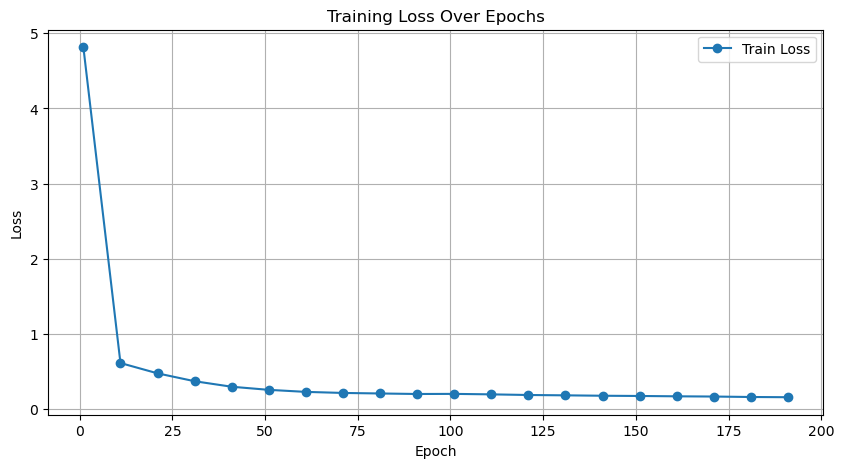

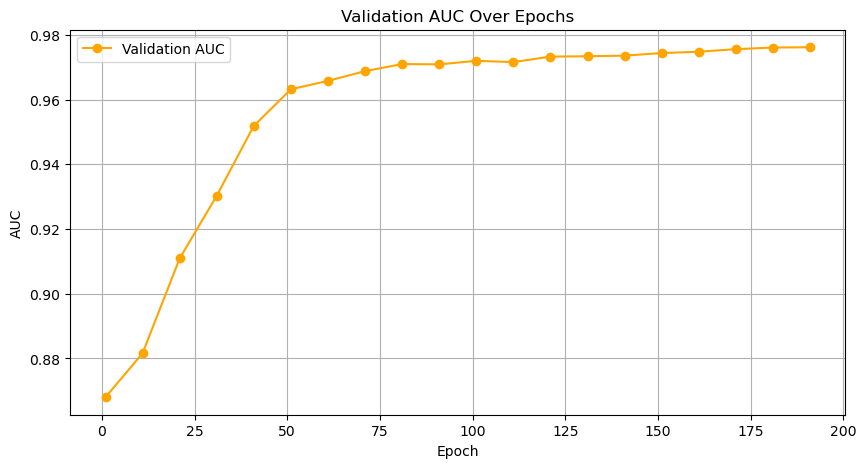

In [28]:
import matplotlib.pyplot as plt

# For demonstration, using your logged data
epochs = [1, 11, 21, 31, 41, 51, 61, 71, 81, 91, 101, 111, 121, 131, 141, 151, 161, 171, 181, 191]
train_losses = [4.8149, 0.6093, 0.4720, 0.3670, 0.2936, 0.2522, 0.2251, 0.2110, 0.2039, 0.1970, 0.1984, 0.1921, 0.1836, 0.1791, 0.1737, 0.1706, 0.1661, 0.1631, 0.1570, 0.1540]
val_aucs = [0.8680, 0.8816, 0.9109, 0.9303, 0.9519, 0.9632, 0.9658, 0.9688, 0.9710, 0.9709, 0.9720, 0.9716, 0.9733, 0.9734, 0.9736, 0.9744, 0.9748, 0.9756, 0.9761, 0.9762]

# Plot training loss
plt.figure(figsize=(10, 5))
plt.plot(epochs, train_losses, label='Train Loss', marker='o')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

# Plot validation AUC
plt.figure(figsize=(10, 5))
plt.plot(epochs, val_aucs, label='Validation AUC', color='orange', marker='o')
plt.xlabel('Epoch')
plt.ylabel('AUC')
plt.title('Validation AUC Over Epochs')
plt.legend()
plt.grid(True)
plt.show()

## miRNA validation

In [29]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [30]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GCNConv, GATConv
from torch_geometric.data import Data
from sklearn.metrics.pairwise import rbf_kernel
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.decomposition import PCA
import optuna
import random
import json
import os

In [31]:
# Set random seed for reproducibility
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)

In [32]:
# Device configuration
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False


In [33]:
def load_data(file_path):
    """Load the dataset from an Excel file."""
    try:
        data = pd.read_excel(file_path)
        return data
    except Exception as e:
        print(f"Error loading data: {e}")
        return None

In [34]:
def preprocess_data(data):
    """Preprocess data into an association matrix."""
    associations = data[['miRNA', 'disease']].drop_duplicates()
    miRNAs = associations['miRNA'].unique()
    diseases = associations['disease'].unique()
    matrix = pd.DataFrame(0, index=miRNAs, columns=diseases)
    matrix.index.name = 'miRNA'
    matrix.columns.name = 'disease'
    for _, row in associations.iterrows():
        if row['miRNA'] in matrix.index and row['disease'] in matrix.columns:
            matrix.loc[row['miRNA'], row['disease']] = 1
    return matrix, miRNAs, diseases

In [35]:
def compute_similarity(matrix):
    """Compute Gaussian Interaction Profile Kernel (GIPK) similarity matrices."""
    gamma_m = 1.0 / (matrix.sum(axis=1).mean() + 1e-10)
    miRNA_sim = pd.DataFrame(rbf_kernel(matrix, gamma=gamma_m), index=matrix.index, columns=matrix.index)
    gamma_d = 1.0 / (matrix.sum(axis=0).mean() + 1e-10)
    disease_sim = pd.DataFrame(rbf_kernel(matrix.T, gamma=gamma_d), index=matrix.columns, columns=matrix.columns)
    return miRNA_sim, disease_sim

In [36]:
def prepare_gcn_data(matrix, miRNA_sim, disease_sim, feature_dim=16):
    """Prepare PyTorch Geometric Data object with node features and edge index."""
    miRNAs = matrix.index
    diseases = matrix.columns
    n_mirnas = len(miRNAs)
    n_diseases = len(diseases)
    pca_m = PCA(n_components=feature_dim, random_state=42)
    miRNA_features = pca_m.fit_transform(miRNA_sim)
    pca_d = PCA(n_components=feature_dim, random_state=42)
    disease_features = pca_d.fit_transform(disease_sim)
    x = torch.tensor(np.vstack([miRNA_features, disease_features]), dtype=torch.float).to(device)
    edges = matrix.stack().reset_index()
    edges = edges[edges[0] == 1]
    miRNA_indices = edges['miRNA'].apply(lambda x: list(miRNAs).index(x)).values
    disease_indices = edges['disease'].apply(lambda x: list(diseases).index(x) + n_mirnas).values
    edge_index = torch.tensor(np.array([miRNA_indices, disease_indices]), dtype=torch.long).to(device)
    edge_index = torch.cat([edge_index, edge_index[[1, 0]]], dim=1)
    return Data(x=x, edge_index=edge_index).to(device), n_mirnas, n_diseases

In [37]:
class MDMF(nn.Module):
    def __init__(self, num_mirnas, num_diseases, latent_dim, lambda_reg):
        super(MDMF, self).__init__()
        torch.manual_seed(42)  # Ensure deterministic initialization
        self.U = nn.Parameter(torch.randn(num_mirnas, latent_dim))
        self.V = nn.Parameter(torch.randn(num_diseases, latent_dim))
        self.lambda_reg = lambda_reg

    def forward(self, A, S_m, S_d):
        recon_loss = F.mse_loss(torch.mm(self.U, self.V.t()), A)
        reg_U = torch.norm(self.U, p=2)
        reg_V = torch.norm(self.V, p=2)
        reg_S_m = torch.norm(torch.mm(self.U, self.U.t()) - S_m, p=2)
        reg_S_d = torch.norm(torch.mm(self.V, self.V.t()) - S_d, p=2)
        loss = recon_loss + self.lambda_reg * (reg_U + reg_V + reg_S_m + reg_S_d)
        return loss

    def get_features(self):
        return self.U, self.V

In [38]:
class HybridGCN_GAT(nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels, dropout, num_heads, num_layers=3):
        super(HybridGCN_GAT, self).__init__()
        self.num_layers = num_layers
        self.dropout = dropout
        self.gcn_layers = nn.ModuleList()
        self.gcn_layers.append(GCNConv(in_channels, hidden_channels))
        for _ in range(num_layers - 2):
            self.gcn_layers.append(GCNConv(hidden_channels, hidden_channels))
        self.gcn_layers.append(GCNConv(hidden_channels, out_channels))
        self.gat_layers = nn.ModuleList()
        self.gat_layers.append(GATConv(in_channels, hidden_channels, heads=num_heads, concat=False))
        for _ in range(num_layers - 2):
            self.gat_layers.append(GATConv(hidden_channels, hidden_channels, heads=num_heads, concat=False))
        self.gat_layers.append(GATConv(hidden_channels, out_channels, heads=num_heads, concat=False))
        self.gcn_residual = nn.Linear(in_channels, out_channels) if in_channels != out_channels else nn.Identity()
        self.gat_residual = nn.Linear(in_channels, out_channels) if in_channels != out_channels else nn.Identity()

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x_gcn = x
        for i, layer in enumerate(self.gcn_layers):
            x_gcn = layer(x_gcn, edge_index)
            if i < self.num_layers - 1:
                x_gcn = x_gcn.relu()
                x_gcn = F.dropout(x_gcn, p=self.dropout, training=self.training)
        x_gcn += self.gcn_residual(x)
        x_gat = x
        for i, layer in enumerate(self.gat_layers):
            x_gat = layer(x_gat, edge_index)
            if i < self.num_layers - 1:
                x_gat = x_gat.relu()
                x_gat = F.dropout(x_gat, p=self.dropout, training=self.training)
        x_gat += self.gat_residual(x)
        x_combined = torch.cat([x_gcn, x_gat], dim=1)
        return x_combined

In [39]:
def evaluate_model(model, data, mask, labels):
    model.eval()
    with torch.no_grad():
        out = model(data)
        mirna_emb, disease_emb = out[:data.n_mirnas], out[data.n_mirnas:]
        pred = (mirna_emb @ disease_emb.t()).view(-1)
        pred_scores = torch.sigmoid(pred[mask]).cpu().numpy()
        auc = roc_auc_score(labels.cpu().numpy(), pred_scores)
    return auc

In [40]:
def train_mdmf(mdmf, A, S_m, S_d, epochs=100, lr=0.01):
    torch.manual_seed(42)  # Ensure deterministic initialization
    optimizer = torch.optim.Adam(mdmf.parameters(), lr=lr)
    mdmf.to(device)
    A, S_m, S_d = A.to(device), S_m.to(device), S_d.to(device)
    for epoch in range(epochs):
        optimizer.zero_grad()
        loss = mdmf(A, S_m, S_d)
        loss.backward()
        optimizer.step()
    return mdmf.get_features()

In [41]:
file_path = 'C:/Users/Basharat Ahmad/Desktop/Final dataset Five fold CV/alldata.xlsx'
data = load_data(file_path)

In [42]:
matrix, miRNAs, diseases = preprocess_data(data)

In [43]:
# Split positive pairs
known_pairs = matrix.stack().reset_index()
known_pairs = known_pairs[known_pairs[0] == 1]
train_val_pairs, test_pairs = train_test_split(known_pairs, test_size=0.15, random_state=42)
train_pairs, val_pairs = train_test_split(train_val_pairs, test_size=0.15/0.85, random_state=42)

train_positive_flats = np.array([matrix.index.get_loc(m) * len(diseases) + matrix.columns.get_loc(d) 
                                    for m, d in zip(train_pairs['miRNA'], train_pairs['disease'])])
val_positive_flats = np.array([matrix.index.get_loc(m) * len(diseases) + matrix.columns.get_loc(d) 
                                for m, d in zip(val_pairs['miRNA'], val_pairs['disease'])])
test_positive_flats = np.array([matrix.index.get_loc(m) * len(diseases) + matrix.columns.get_loc(d) 
                                for m, d in zip(test_pairs['miRNA'], test_pairs['disease'])])

flat_matrix = matrix.values.flatten()
negative_flats = np.where(flat_matrix == 0)[0]

train_negative_flats = np.random.choice(negative_flats, size=len(train_positive_flats), replace=False)
remaining_negative_flats = np.setdiff1d(negative_flats, train_negative_flats)
val_negative_flats = np.random.choice(remaining_negative_flats, size=len(val_positive_flats), replace=False)
remaining_negative_flats = np.setdiff1d(remaining_negative_flats, val_negative_flats)
test_negative_flats = np.random.choice(remaining_negative_flats, size=len(test_positive_flats), replace=False)


In [44]:
train_mask = np.concatenate([train_positive_flats, train_negative_flats])
train_labels = torch.tensor(np.concatenate([np.ones(len(train_positive_flats)), np.zeros(len(train_negative_flats))]), 
                            dtype=torch.float).to(device)

val_mask = np.concatenate([val_positive_flats, val_negative_flats])
val_labels = torch.tensor(np.concatenate([np.ones(len(val_positive_flats)), np.zeros(len(val_negative_flats))]), 
                            dtype=torch.float).to(device)

test_mask = np.concatenate([test_positive_flats, test_negative_flats])
test_labels = torch.tensor(np.concatenate([np.ones(len(test_positive_flats)), np.zeros(len(test_negative_flats))]), 
                            dtype=torch.float).to(device)

train_val_mask = np.concatenate([train_mask, val_mask])
train_val_labels = torch.tensor(np.concatenate([train_labels.cpu().numpy(), val_labels.cpu().numpy()]), 
                                dtype=torch.float).to(device)


In [45]:
with open('best_params.json', 'r') as f:
    best_params = json.load(f)

# Final model with best hyperparameters
best_pca_dim = best_params['pca_dim']
best_latent_dim = best_params['latent_dim']
best_lambda_reg = best_params['lambda_reg']
best_hidden_dim = best_params['hidden_dim']
best_out_channels = best_params['out_channels']
best_dropout = best_params['dropout']
best_num_heads = best_params['num_heads']
best_num_layers = best_params['num_layers']
best_learning_rate = best_params['learning_rate']
best_weight_decay = best_params['weight_decay']

In [46]:
# Prepare final data
miRNA_sim, disease_sim = compute_similarity(matrix)
gcn_data_final, n_mirnas, n_diseases = prepare_gcn_data(matrix, miRNA_sim, disease_sim, feature_dim=best_pca_dim)
gcn_data_final.n_mirnas = n_mirnas

# Train MDMF with best parameters
mdmf_final = MDMF(num_mirnas=len(miRNAs), num_diseases=len(diseases), latent_dim=best_latent_dim, 
                    lambda_reg=best_lambda_reg)
U_final, V_final = train_mdmf(mdmf_final, torch.tensor(matrix.values, dtype=torch.float),
                                torch.tensor(miRNA_sim.values, dtype=torch.float),
                                torch.tensor(disease_sim.values, dtype=torch.float))


In [47]:
# Save MDMF features
# os.makedirs('models', exist_ok=True)
# torch.save({'U': U_final, 'V': V_final}, 'models/mdmf_features.pth')

mdmf_features_final = torch.cat([U_final, V_final], dim=0).to(device)
gcn_data_final.x = torch.cat([gcn_data_final.x, mdmf_features_final], dim=1)

In [48]:
# Load and test saved model
model_loaded = HybridGCN_GAT(
    in_channels=gcn_data_final.x.shape[1],
    hidden_channels=best_hidden_dim,
    out_channels=best_out_channels,
    dropout=best_dropout,
    num_heads=best_num_heads,
    num_layers=best_num_layers
)

saved_model_path = 'models/model_final11.pth'

model_loaded.load_state_dict(torch.load(saved_model_path, map_location=device))
model_loaded.to(device)

HybridGCN_GAT(
  (gcn_layers): ModuleList(
    (0): GCNConv(52, 230)
    (1): GCNConv(230, 25)
  )
  (gat_layers): ModuleList(
    (0): GATConv(52, 230, heads=13)
    (1): GATConv(230, 25, heads=13)
  )
  (gcn_residual): Linear(in_features=52, out_features=25, bias=True)
  (gat_residual): Linear(in_features=52, out_features=25, bias=True)
)

In [49]:
test_auc_loaded = evaluate_model(model_loaded, gcn_data_final, test_mask, test_labels.to(device))
print(f"Loaded Model Test AUC: {test_auc_loaded:.4f}")

Loaded Model Test AUC: 0.9770


In [50]:
def get_prediction_scores(model, data, mask):
    model.eval()
    with torch.no_grad():
        out = model(data.to(device))
        mirna_emb, disease_emb = out[:data.n_mirnas], out[data.n_mirnas:]
        pred = (mirna_emb @ disease_emb.t()).view(-1)
        pred_scores = torch.sigmoid(pred[mask]).cpu().numpy()
    return pred_scores

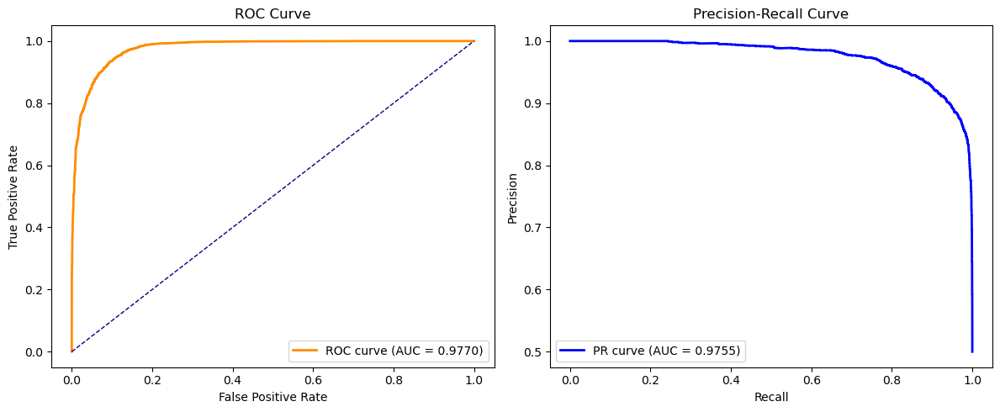

In [51]:
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt

# Get prediction scores and true labels
y_scores = get_prediction_scores(model_loaded, gcn_data_final, test_mask)
y_true = test_labels.cpu().numpy()

# Compute ROC metrics
fpr, tpr, _ = roc_curve(y_true, y_scores)
roc_auc = auc(fpr, tpr)

# Compute PR metrics
precision, recall, _ = precision_recall_curve(y_true, y_scores)
pr_auc = average_precision_score(y_true, y_scores)

# Plotting
plt.figure(figsize=(12, 5))

# ROC Curve
plt.subplot(1, 2, 1)
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.4f})')
plt.plot([0, 1], [0, 1], color='navy', linestyle='--', lw=1)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')

# Precision-Recall Curve
plt.subplot(1, 2, 2)
plt.plot(recall, precision, color='blue', lw=2, label=f'PR curve (AUC = {pr_auc:.4f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc='lower left')

plt.tight_layout()
plt.show()

In [52]:
def evaluate_model_new(model, data, mask, labels):
    model.eval()
    with torch.no_grad():
        out = model(data)
        mirna_emb, disease_emb = out[:data.n_mirnas], out[data.n_mirnas:]
        pred = (mirna_emb @ disease_emb.t()).view(-1)
        pred_scores = torch.sigmoid(pred[mask]).cpu().numpy()
        true_labels = labels.cpu().numpy()
        auc = roc_auc_score(true_labels, pred_scores)
    return auc, pred_scores, true_labels

Loaded Model Test AUC: 0.9770


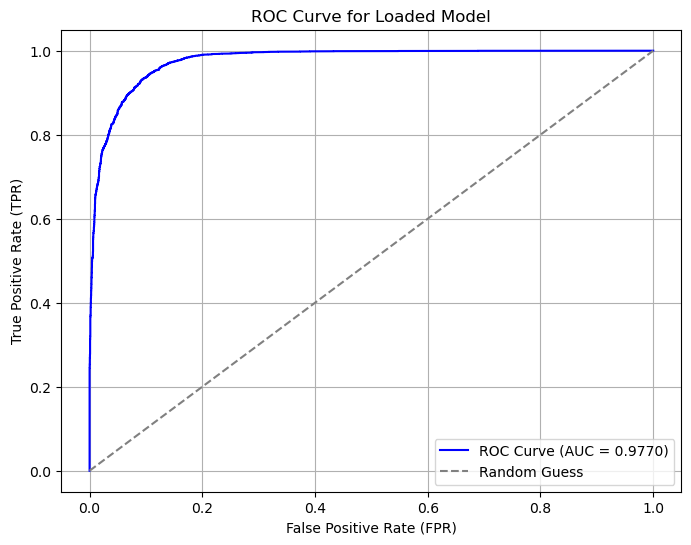

In [53]:
# Evaluate the model and get AUC, pred_scores, and true_labels
test_auc_loaded, pred_scores, true_labels = evaluate_model_new(model_loaded, gcn_data_final, test_mask, test_labels.to(device))
print(f"Loaded Model Test AUC: {test_auc_loaded:.4f}")

# Compute FPR and TPR for ROC curve
fpr, tpr, thresholds = roc_curve(true_labels, pred_scores)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f'ROC Curve (AUC = {test_auc_loaded:.4f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label='Random Guess')
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('ROC Curve for Loaded Model')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

In [54]:
import networkx as nx
import matplotlib.pyplot as plt

# Create a directed graph
G = nx.DiGraph()

# Add nodes with attributes
for mirna in miRNAs:
    G.add_node(mirna, node_type='miRNA')
for disease in diseases:
    G.add_node(disease, node_type='disease')

# Add bidirectional edges for known associations
for mirna in miRNAs:
    for disease in diseases:
        if matrix.loc[mirna, disease] == 1:
            G.add_edge(mirna, disease)
            G.add_edge(disease, mirna)


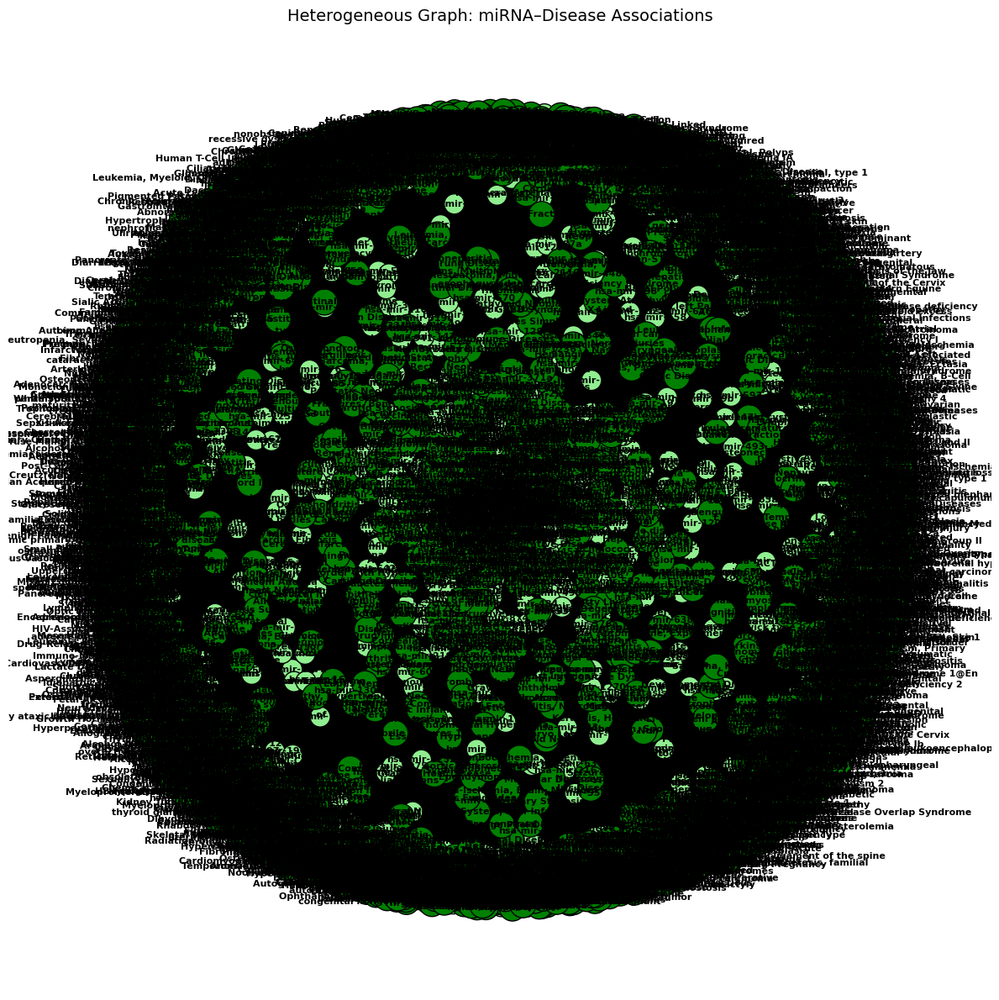

In [55]:
# Position layout
pos = nx.spring_layout(G, seed=42, k=0.5)

# Style nodes
node_colors = []
node_sizes = []

for node in G.nodes():
    if G.nodes[node]['node_type'] == 'miRNA':
        node_colors.append('lightgreen')
        node_sizes.append(300)
    else:
        node_colors.append('green')
        node_sizes.append(500)

# Draw graph
plt.figure(figsize=(12, 12))
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, edgecolors='black')
nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle='-|>', arrowsize=10, edge_color='black', connectionstyle='arc3,rad=0.1')
nx.draw_networkx_labels(G, pos, font_size=8, font_weight='bold')

plt.axis('off')
plt.title("Heterogeneous Graph: miRNA–Disease Associations", fontsize=14)
plt.tight_layout()
plt.show()

In [56]:
heart_terms = ['cardiac', 'heart', 'cardiomyopathy', 'myocardial', 'ischemic', 'cardiovascular']
cancer = ['Cancer Pain']

# Filter diseases based on these terms (case insensitive)
heart_diseases = [d for d in diseases if any(term in d.lower() for term in heart_terms)]

# Filter matrix and miRNAs based on those diseases
filtered_matrix = matrix[heart_diseases]
filtered_miRNAs = filtered_matrix.loc[:, (filtered_matrix != 0).any(axis=0)].index


## made changes in paper according to this points 

In [57]:
len(heart_diseases)

75

In [58]:
G = nx.DiGraph()

# Add filtered nodes
for mirna in filtered_miRNAs:
    G.add_node(mirna, node_type='miRNA')
for disease in heart_diseases:
    G.add_node(disease, node_type='disease')

# Add edges (both directions for message passing)
for mirna in filtered_miRNAs:
    for disease in heart_diseases:
        if filtered_matrix.loc[mirna, disease] == 1:
            G.add_edge(mirna, disease)
            G.add_edge(disease, mirna)

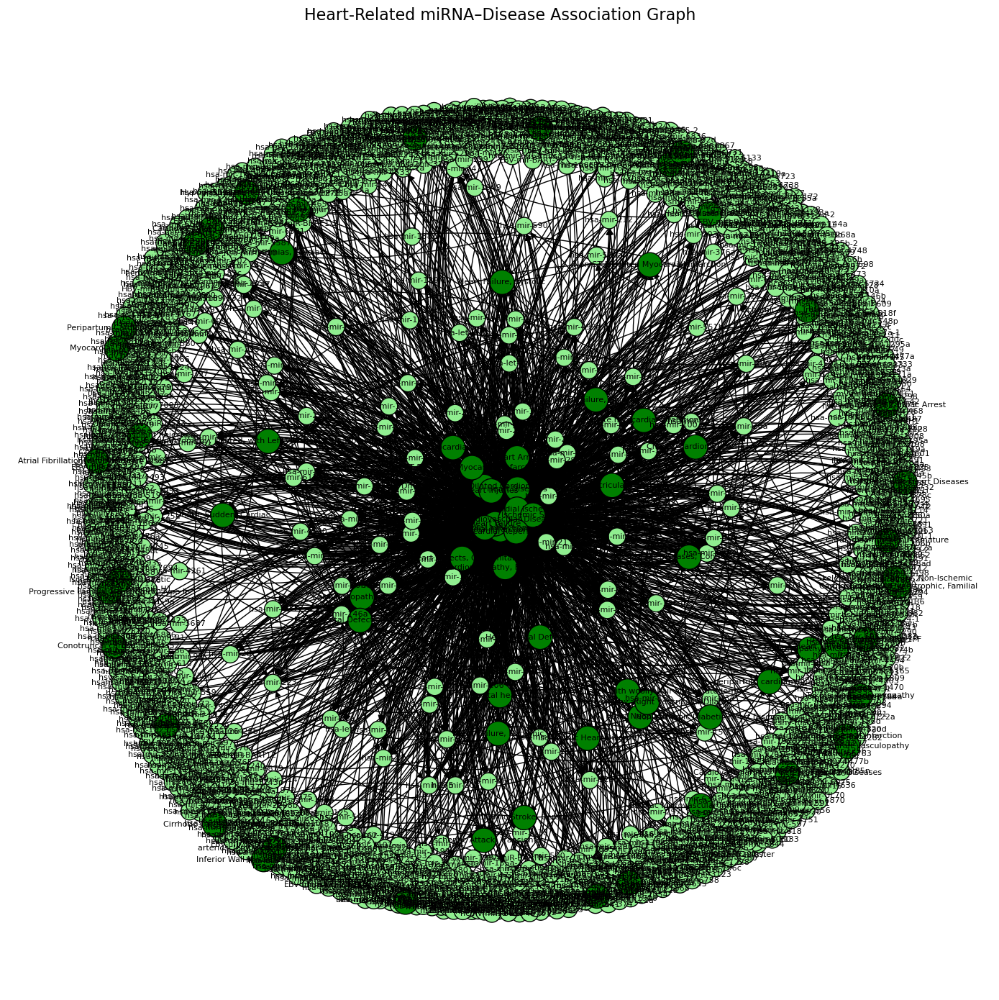

In [59]:
plt.figure(figsize=(14, 14))

pos = nx.spring_layout(G, seed=42, k=0.5)

node_colors = ['lightgreen' if G.nodes[n]['node_type'] == 'miRNA' else 'green' for n in G.nodes()]
node_sizes = [300 if G.nodes[n]['node_type'] == 'miRNA' else 600 for n in G.nodes()]

nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, edgecolors='black')
nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle='-|>', arrowsize=12, edge_color='black', connectionstyle='arc3,rad=0.2')
nx.draw_networkx_labels(G, pos, font_size=8)

plt.title("Heart-Related miRNA–Disease Association Graph", fontsize=16)
plt.axis('off')
plt.tight_layout()
plt.savefig("heart_miRNA_disease_graph.png", dpi=400)
plt.show()

In [60]:
print("Dataset shape:", data.shape)

matrix, miRNAs, diseases = preprocess_data(data)

distinct_pairs = data[['miRNA', 'disease']].drop_duplicates()
print("Distinct pairs:", len(distinct_pairs))

miRNAs_pairs = distinct_pairs['miRNA'].unique()
diseases_unique = distinct_pairs['disease'].unique()
print("Unique miRNAs:", len(miRNAs_pairs))
print("Unique diseases:", len(diseases_unique))

filtered = (distinct_pairs
            .groupby('miRNA')
            .filter(lambda x: len(x) >= 5)
            .groupby('disease')
            .filter(lambda x: len(x) >= 35)
            .reset_index(drop=True))
print("Filtered pairs:", len(filtered))

miRNAs_filtered = filtered['miRNA'].unique()
diseases_filtered = filtered['disease'].unique()

print("Unique miRNAs in Filtered pairs:", len(miRNAs_filtered))
print("Unique diseases in Filtered pairs:", len(diseases_filtered))

heart_diseases = [d for d in diseases if any(term in d.lower() for term in heart_terms)]
print("Heart diseases:", len(heart_diseases), heart_diseases)


heart_diseases_filtered = [d for d in diseases_filtered if any(term.lower() in d.lower() for term in heart_terms)]
print("Filtered Heart diseases:", len(heart_diseases_filtered), heart_diseases_filtered)

heart_filtered = filtered[filtered['disease'].isin(heart_diseases_filtered)]
print("Final heart-related pairs:", len(heart_filtered))

Dataset shape: (53530, 5)
Distinct pairs: 31461
Unique miRNAs: 1911
Unique diseases: 2360
Filtered pairs: 18737
Unique miRNAs in Filtered pairs: 728
Unique diseases in Filtered pairs: 175
Heart diseases: 75 ['Myocardial Infarction, Acute', 'arteriosclerotic cardiovascular disease', 'acute myocardial infarction', 'peripartum cardiomyopathy', 'Dilated Cardiomyopathy ', 'dilated cardiomyopathy 1FF', 'Heart Failure', 'Myocardial Infarction', 'Cardiovascular Diseases', 'Ischemic Attack, Transient', 'Heart Arrest', 'Heart Diseases', 'Myocardial Ischemia', 'Heart Neoplasms', 'Cardiomyopathy, Hypertrophic', 'Dmd-Associated Dilated Cardiomyopathy', 'Heart Failure, Acute', 'Cardiomyopathy, Dilated, with Left Ventricular Noncompaction', 'Heart Failure, Systolic', 'Chagas Cardiomyopathy', 'Heart Failure, Ischemic', 'Cardiomyopathy, Dilated', 'Ischemic Stroke', 'Myocardial Reperfusion Injury', 'ST Elevation Myocardial Infarction', 'Cardiovascular Complications', 'Death, Sudden, Cardiac', 'Hypoplast

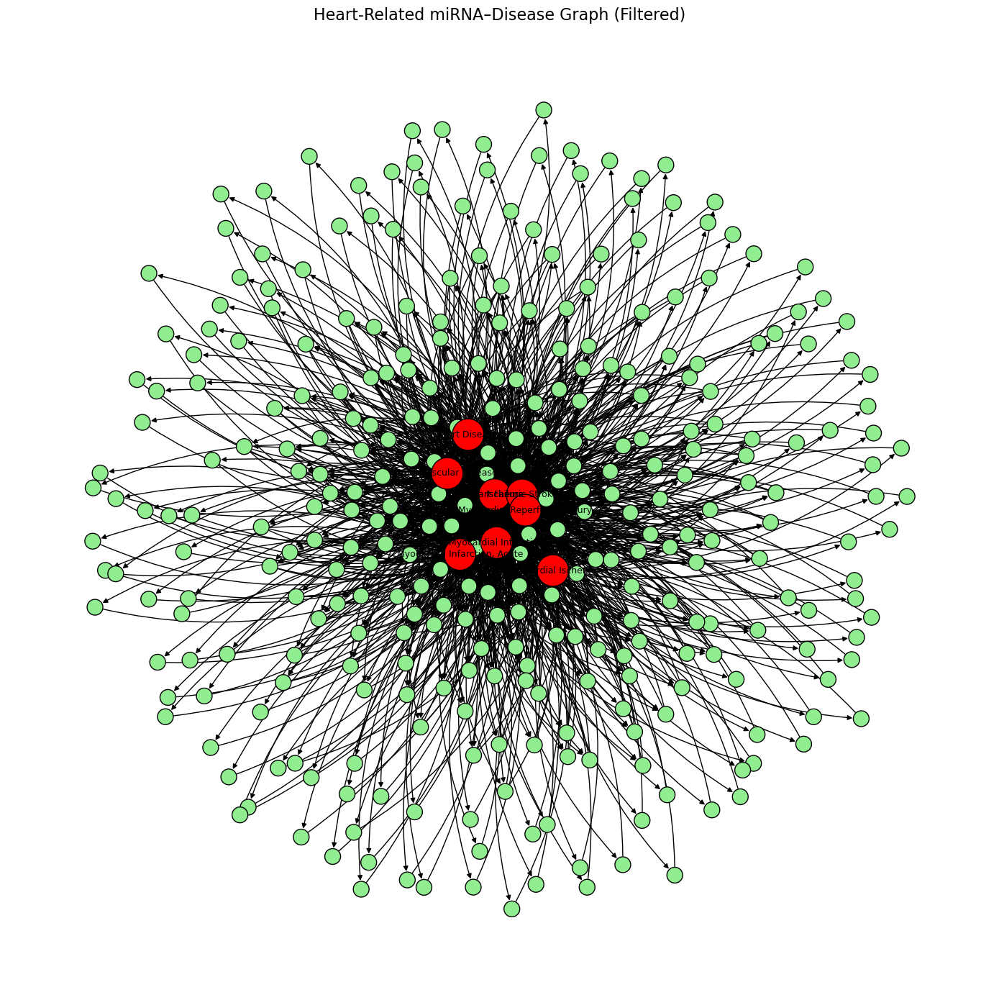

In [61]:
import networkx as nx
import matplotlib.pyplot as plt

# Create the graph
G = nx.DiGraph()

# Add nodes
for mirna in heart_filtered['miRNA'].unique():
    G.add_node(mirna, node_type='miRNA')
for disease in heart_filtered['disease'].unique():
    G.add_node(disease, node_type='disease')

# Add edges
for _, row in heart_filtered.iterrows():
    G.add_edge(row['miRNA'], row['disease'])
    G.add_edge(row['disease'], row['miRNA'])

# Layout
plt.figure(figsize=(14, 14))
pos = nx.spring_layout(G, seed=42, k=0.4)

# Colors & sizes
node_colors = ['lightgreen' if G.nodes[n]['node_type'] == 'miRNA' else 'red' for n in G.nodes()]
node_sizes = [250 if G.nodes[n]['node_type'] == 'miRNA' else 1000 for n in G.nodes()]

# Draw
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, edgecolors='black')
nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle='-|>', arrowsize=10, edge_color='black', connectionstyle='arc3,rad=0.2')

# Only show disease labels
labels = {n: n for n in G.nodes() if G.nodes[n]['node_type'] == 'disease'}
nx.draw_networkx_labels(G, pos, labels=labels, font_size=9)

plt.title("Heart-Related miRNA–Disease Graph (Filtered)", fontsize=16)
plt.axis('off')
plt.tight_layout()
plt.savefig("heart_filtered_graph.png", dpi=500)
plt.show()


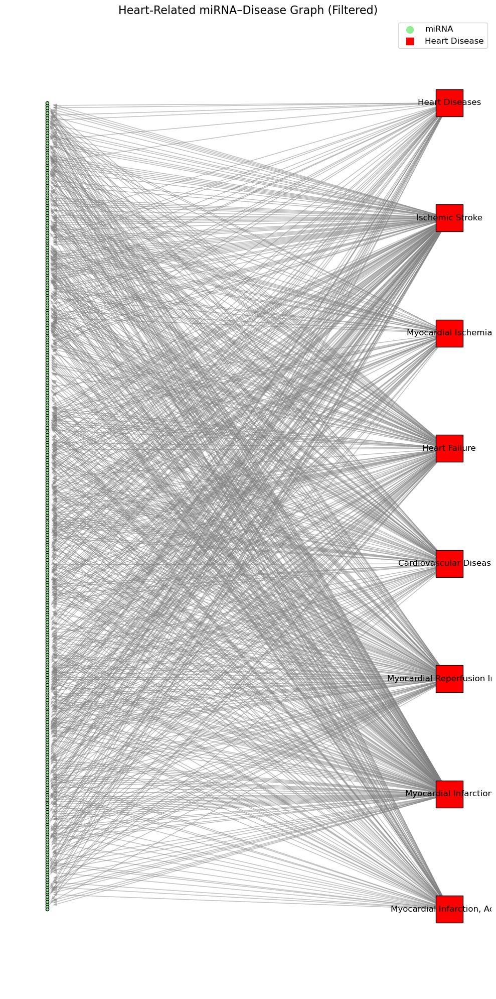

In [62]:
# Create the graph
G = nx.DiGraph()

# Add nodes
for mirna in heart_filtered['miRNA'].unique():
    G.add_node(mirna, node_type='miRNA')
for disease in heart_filtered['disease'].unique():
    G.add_node(disease, node_type='disease')

# Add edges
for _, row in heart_filtered.iterrows():
    G.add_edge(row['miRNA'], row['disease'])
    G.add_edge(row['disease'], row['miRNA'])

# Get node lists for bipartite layout
mirna_nodes = [n for n in G.nodes() if G.nodes[n]['node_type'] == 'miRNA']
disease_nodes = [n for n in G.nodes() if G.nodes[n]['node_type'] == 'disease']

# Set up figure with a taller aspect ratio
plt.figure(figsize=(10, 20))

# Use bipartite layout
pos = nx.bipartite_layout(G, mirna_nodes, align='vertical', scale=2)

# Draw nodes with different shapes and sizes
nx.draw_networkx_nodes(G, pos, nodelist=mirna_nodes, node_color='lightgreen', node_size=20, node_shape='o', edgecolors='black')
nx.draw_networkx_nodes(G, pos, nodelist=disease_nodes, node_color='red', node_size=1500, node_shape='s', edgecolors='black')

# Draw edges with transparency and straight lines
nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle='-|>', arrowsize=10, edge_color='gray', alpha=0.3, connectionstyle='arc3,rad=0')

# Draw labels for disease nodes only
labels = {n: n for n in disease_nodes}
nx.draw_networkx_labels(G, pos, labels=labels, font_size=12)

# Add legend
plt.scatter([], [], c='lightgreen', marker='o', label='miRNA', s=100)
plt.scatter([], [], c='red', marker='s', label='Heart Disease', s=100)
plt.legend(loc='upper right', fontsize=12)

# Set title and remove axes
plt.title("Heart-Related miRNA–Disease Graph (Filtered)", fontsize=16)
plt.axis('off')
plt.tight_layout()

# Save and display
plt.savefig("heart_filtered_graph_improved.png", dpi=500)
plt.show()

In [63]:
filtered[filtered['disease'].isin(heart_diseases)]

,miRNA,disease
2,hsa-mir-21,"Myocardial Infarction, Acute"
6,hsa-mir-155,"Myocardial Infarction, Acute"
10,hsa-mir-150,"Myocardial Infarction, Acute"
12,hsa-mir-146a,"Myocardial Infarction, Acute"
19,hsa-mir-92a,"Myocardial Infarction, Acute"
...,...,...
18370,hsa-mir-1298,Myocardial Reperfusion Injury
18497,hsa-mir-1322,Myocardial Ischemia
18573,hsa-mir-4486,Myocardial Infarction
18623,hsa-mir-2355,Myocardial Reperfusion Injury


In [64]:
# Count unique miRNAs per heart disease (filtered set only)
heart_disease_counts = (
    filtered[filtered['disease'].isin(heart_diseases_filtered)]
    .groupby('disease')['miRNA']
    .nunique()
    .sort_values(ascending=False)
)

top_heart_diseases = heart_disease_counts.index.tolist()

print(f"Top heart diseases by unique miRNA count:\n", top_heart_diseases)

Top heart diseases by unique miRNA count:
 ['Myocardial Infarction', 'Ischemic Stroke', 'Heart Failure', 'Myocardial Reperfusion Injury', 'Cardiovascular Diseases', 'Myocardial Infarction, Acute', 'Myocardial Ischemia', 'Heart Diseases']


In [65]:
heart_disease_counts

disease
Myocardial Infarction            160
Ischemic Stroke                  155
Heart Failure                    115
Myocardial Reperfusion Injury    114
Cardiovascular Diseases           85
Myocardial Infarction, Acute      79
Myocardial Ischemia               61
Heart Diseases                    51
Name: miRNA, dtype: int64

In [66]:
# number of rows where a miRNA is linked to one of the top 8 diseases (some miRNAs appear multiple times).

top_heart_filtered = filtered[filtered['disease'].isin(top_heart_diseases)]
print("Filtered pairs (top heart diseases):", len(top_heart_filtered))


Filtered pairs (top heart diseases): 820


In [67]:
# number of distinct miRNA names involved in those 820 rows

miRNAs_top_diseases = filtered[filtered['disease'].isin(top_heart_diseases)]['miRNA'].unique()

print("Total unique miRNAs across top 8 diseases:", len(miRNAs_top_diseases))


Total unique miRNAs across top 8 diseases: 324


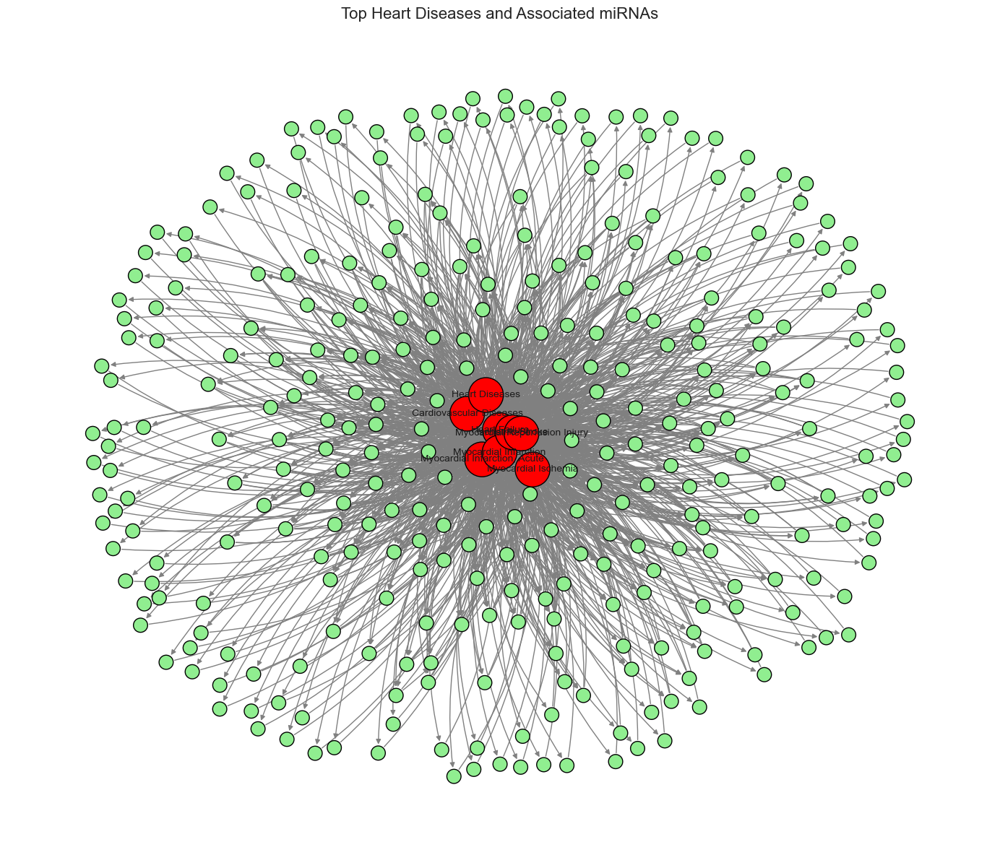

In [115]:
import networkx as nx
import matplotlib.pyplot as plt

G = nx.DiGraph()

# Add nodes
for mirna in top_heart_filtered['miRNA'].unique():
    G.add_node(mirna, node_type='miRNA')
for disease in top_heart_filtered['disease'].unique():
    G.add_node(disease, node_type='disease')

# Add edges (bidirectional for better visibility)
for _, row in top_heart_filtered.iterrows():
    G.add_edge(row['miRNA'], row['disease'])
    G.add_edge(row['disease'], row['miRNA'])

# Layout
plt.figure(figsize=(14, 12))
pos = nx.spring_layout(G, seed=42, k=0.5)

# Colors & sizes
node_colors = ['lightgreen' if G.nodes[n]['node_type'] == 'miRNA' else 'red' for n in G.nodes()]
node_sizes = [200 if G.nodes[n]['node_type'] == 'miRNA' else 1200 for n in G.nodes()]

# Draw graph
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, edgecolors='black')
nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle='-|>', arrowsize=10, edge_color='gray', connectionstyle='arc3,rad=0.2')

# Labels: only for diseases
labels = {n: n for n in G.nodes() if G.nodes[n]['node_type'] == 'disease'}
nx.draw_networkx_labels(G, pos, labels=labels, font_size=10)

# Title & layout
plt.title(f"Top Heart Diseases and Associated miRNAs", fontsize=16)
plt.axis('off')
plt.tight_layout()
plt.savefig(f"top_heart_diseases_graph.png", dpi=500)
plt.show()

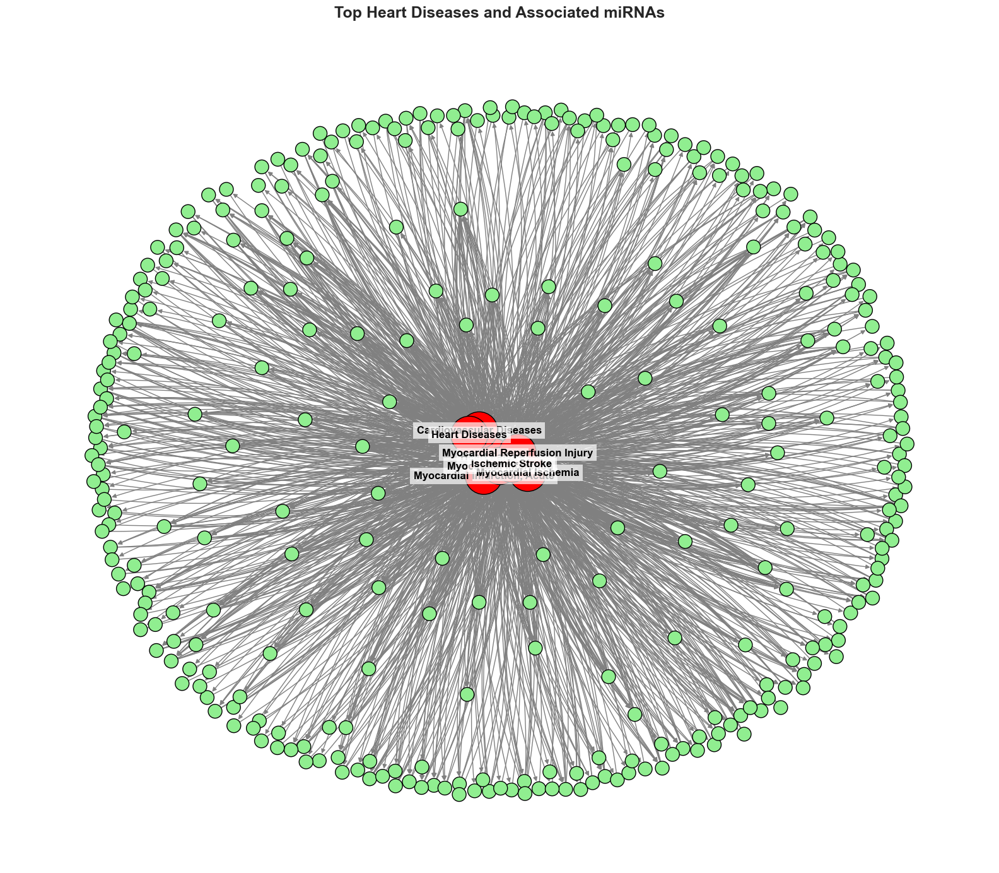

In [116]:
import networkx as nx
import matplotlib.pyplot as plt

G = nx.DiGraph()

# Add nodes
for mirna in top_heart_filtered['miRNA'].unique():
    G.add_node(mirna, node_type='miRNA')
for disease in top_heart_filtered['disease'].unique():
    G.add_node(disease, node_type='disease')

# Add edges (bidirectional for better visibility)
for _, row in top_heart_filtered.iterrows():
    G.add_edge(row['miRNA'], row['disease'])
    G.add_edge(row['disease'], row['miRNA'])

# Layout (increase k for more spacing)
plt.figure(figsize=(16, 14))
pos = nx.spring_layout(G, seed=42, k=1.5, iterations=100)

# Colors & sizes
node_colors = ['lightgreen' if G.nodes[n]['node_type'] == 'miRNA' else 'red' for n in G.nodes()]
node_sizes = [250 if G.nodes[n]['node_type'] == 'miRNA' else 1800 for n in G.nodes()]

# Draw graph
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, edgecolors='black')
nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle='-|>', arrowsize=10, edge_color='gray', connectionstyle='arc3,rad=0.1')

# Labels: only for diseases (larger font + background box)
labels = {n: n for n in G.nodes() if G.nodes[n]['node_type'] == 'disease'}
nx.draw_networkx_labels(G, pos, labels=labels, font_size=12, font_weight='bold',
                        font_color='black', bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))

# Title & layout
plt.title("Top Heart Diseases and Associated miRNAs", fontsize=18, fontweight='bold', pad=20)
plt.axis('off')
plt.tight_layout()
plt.savefig("top_heart_diseases_graph_improved.png", dpi=600, bbox_inches='tight')
plt.show()


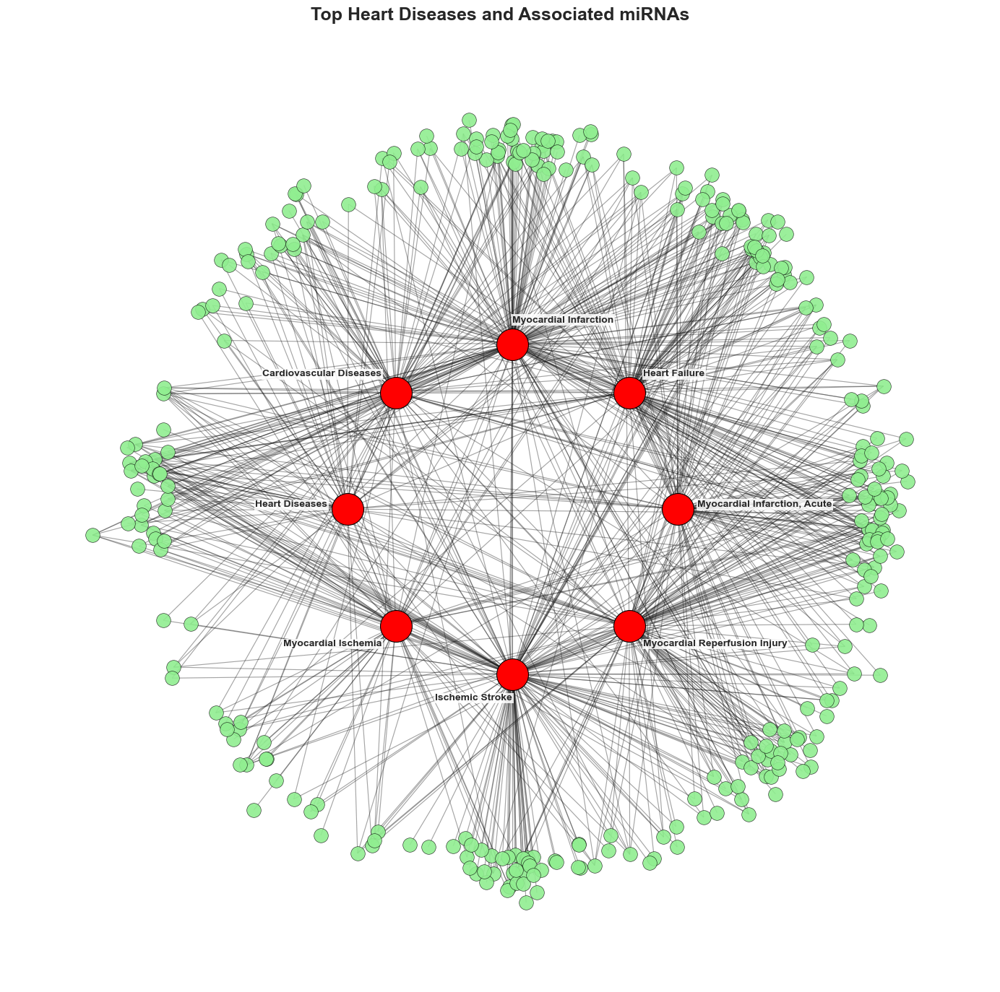

In [117]:
import math
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt

# Build graph (same as your code) ------------------------------------------------
G = nx.DiGraph()
for mirna in top_heart_filtered['miRNA'].unique():
    G.add_node(mirna, node_type='miRNA')
for disease in top_heart_filtered['disease'].unique():
    G.add_node(disease, node_type='disease')

for _, row in top_heart_filtered.iterrows():
    G.add_edge(row['miRNA'], row['disease'])
    G.add_edge(row['disease'], row['miRNA'])

# Prepare nodes lists -----------------------------------------------------------
diseases = [n for n in G.nodes() if G.nodes[n]['node_type'] == 'disease']
mirnas   = [n for n in G.nodes() if G.nodes[n]['node_type'] == 'miRNA']

# Parameters you can tune -------------------------------------------------------
seed = 42
rng = np.random.RandomState(seed)
n_d = len(diseases)
n_m = len(mirnas)

# radius for disease circle, increase for more separation when many diseases
r_disease = max(1.0, n_d / 6.0)        # e.g., if many diseases -> larger circle
radial_gap = 1.6                       # distance from disease ring to miRNA ring
jitter = 0.12                          # angle jitter for miRNA placement (radians)
label_pad = 1.12                       # how far label sits from node (multiplier)
miRNA_jitter_r = 0.12                  # small radial jitter for miRNA radius

# Compute disease positions evenly distributed on a circle ----------------------
angles_d = np.linspace(0, 2 * np.pi, n_d, endpoint=False)
pos = {}
for i, d in enumerate(diseases):
    ang = angles_d[i]
    pos[d] = np.array([r_disease * math.cos(ang), r_disease * math.sin(ang)])

# Map disease -> angle for quick lookup
disease_angle = {d: angles_d[i] for i, d in enumerate(diseases)}

# Place miRNAs by averaging the angles of connected diseases (or random if none) -
for m in mirnas:
    # collect connected diseases (either direction)
    neighs = set([nbr for nbr in G.successors(m)] + [nbr for nbr in G.predecessors(m)])
    neigh_diseases = [n for n in neighs if G.nodes[n]['node_type'] == 'disease']

    if len(neigh_diseases) == 0:
        # put isolated miRNAs randomly on outer ring
        ang = rng.uniform(0, 2 * np.pi)
    else:
        # average angles robustly using vector average (handles wrap-around)
        xs = np.sum([math.cos(disease_angle[d]) for d in neigh_diseases])
        ys = np.sum([math.sin(disease_angle[d]) for d in neigh_diseases])
        ang = math.atan2(ys, xs)

    # add a tiny jitter so many miRNAs near same angle don't stack exactly
    ang = ang + rng.normal(scale=jitter)

    r_m = r_disease + radial_gap + rng.normal(scale=miRNA_jitter_r)
    pos[m] = np.array([r_m * math.cos(ang), r_m * math.sin(ang)])

# Now draw ---------------------------------------------------------------------
plt.figure(figsize=(14, 14))
ax = plt.gca()

# Node drawing
disease_nodes = diseases
mirna_nodes = mirnas

nx.draw_networkx_nodes(G, pos, nodelist=mirna_nodes,
                       node_color='lightgreen', node_size=200, edgecolors='black', linewidths=0.4, alpha=0.9)
nx.draw_networkx_nodes(G, pos, nodelist=disease_nodes,
                       node_color='red', node_size=1000, edgecolors='black', linewidths=0.8)

# Edges (draw faint lines so labels remain readable)
nx.draw_networkx_edges(G, pos, edgelist=[e for e in G.edges()],
                       arrows=False, alpha=0.22, width=0.8)

# Disease labels placed slightly outside each disease node and aligned by angle
for d in disease_nodes:
    x, y = pos[d]
    ang = math.atan2(y, x)
    # shift text slightly outward along radial direction
    x_text = x * label_pad
    y_text = y * label_pad

    # choose alignment based on angle so text doesn't cross the node
    ha = 'left' if math.cos(ang) >= 0 else 'right'
    va = 'bottom' if math.sin(ang) >= 0 else 'top'

    ax.text(x_text, y_text, d,
            fontsize=10, fontweight='bold', ha=ha, va=va,
            bbox=dict(facecolor='white', alpha=0.85, edgecolor='none', pad=1.0))

# Optionally: lighten miRNA labels or hide them (here we hide to reduce clutter)
# If you want to label miRNAs too, uncomment below and adjust fontsize.
# nx.draw_networkx_labels(G, pos, labels={m: m for m in mirnas}, font_size=7)

# Final cosmetics
ax.set_aspect('equal')
plt.title("Top Heart Diseases and Associated miRNAs", fontsize=18, fontweight='bold', pad=18)
plt.axis('off')
plt.tight_layout()
plt.savefig("top_heart_diseases_spaced.png", dpi=400, bbox_inches='tight')
plt.show()


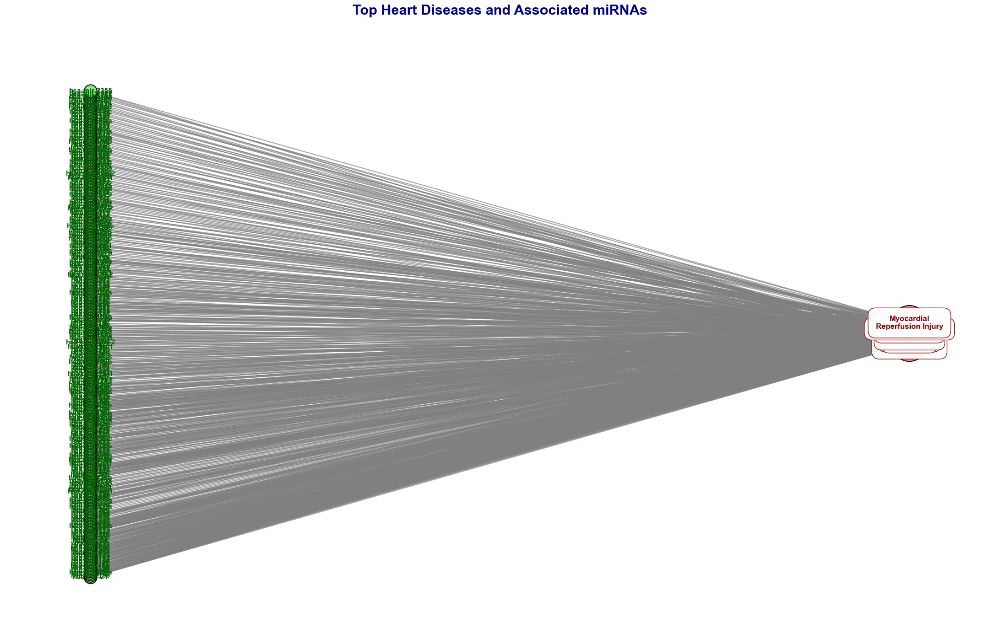

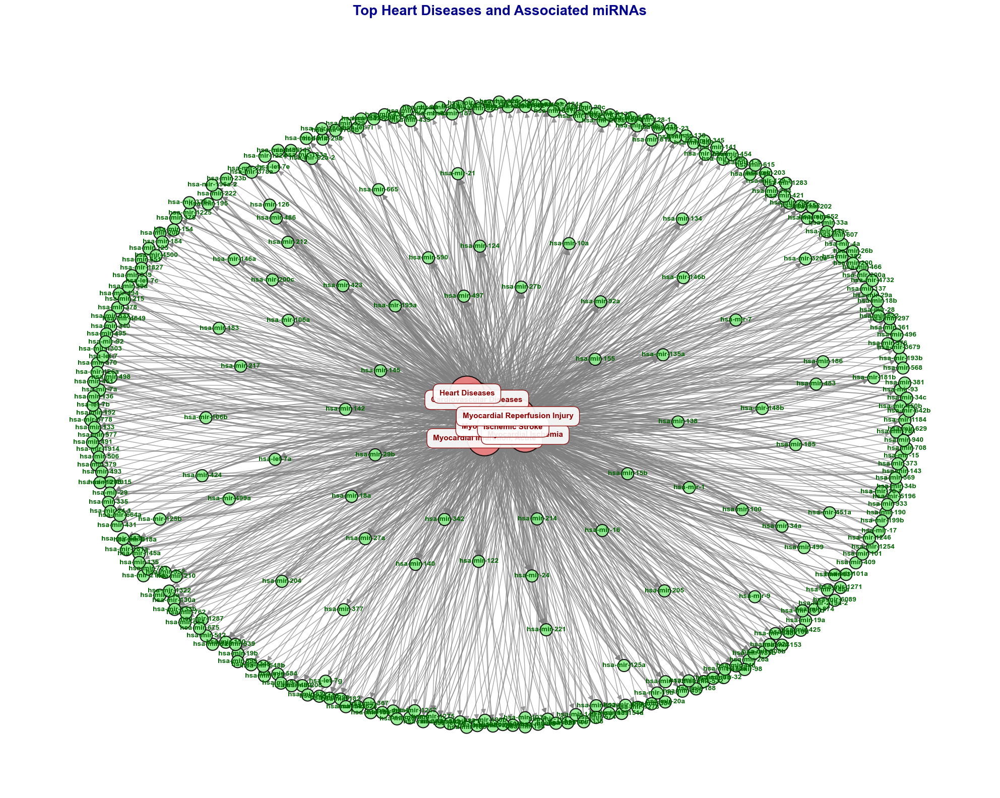

In [119]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

G = nx.DiGraph()

# Add nodes
for mirna in top_heart_filtered['miRNA'].unique():
    G.add_node(mirna, node_type='miRNA')
for disease in top_heart_filtered['disease'].unique():
    G.add_node(disease, node_type='disease')

# Add edges (bidirectional for better visibility)
for _, row in top_heart_filtered.iterrows():
    G.add_edge(row['miRNA'], row['disease'])
    G.add_edge(row['disease'], row['miRNA'])

# Create a larger figure
plt.figure(figsize=(20, 16))

# Use a layout that provides better spacing
pos = nx.spring_layout(G, seed=42, k=3, iterations=200)

# Manually adjust positions for disease nodes to prevent overlap
disease_nodes = [n for n in G.nodes() if G.nodes[n]['node_type'] == 'disease']
mirna_nodes = [n for n in G.nodes() if G.nodes[n]['node_type'] == 'miRNA']

# Colors & sizes - make disease nodes larger
node_colors = ['lightgreen' if G.nodes[n]['node_type'] == 'miRNA' else 'lightcoral' for n in G.nodes()]
node_sizes = [300 if G.nodes[n]['node_type'] == 'miRNA' else 2500 for n in G.nodes()]

# Draw graph
nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, 
                      edgecolors='black', linewidths=1.5, alpha=0.9)

# Draw edges with curvature
nx.draw_networkx_edges(G, pos, arrows=True, arrowstyle='-|>', arrowsize=15, 
                      edge_color='gray', alpha=0.7, connectionstyle='arc3,rad=0.1')

# Draw miRNA labels
mirna_labels = {n: n for n in mirna_nodes}
nx.draw_networkx_labels(G, pos, labels=mirna_labels, font_size=10, 
                       font_weight='bold', font_color='darkgreen')

# Draw disease labels with improved formatting
disease_labels = {n: n for n in disease_nodes}
nx.draw_networkx_labels(G, pos, labels=disease_labels, font_size=11, 
                       font_weight='bold', font_color='darkred',
                       bbox=dict(facecolor='white', edgecolor='darkred', 
                                alpha=0.9, boxstyle='round,pad=0.8'))

# Title & layout
plt.title("Top Heart Diseases and Associated miRNAs", fontsize=20, 
          fontweight='bold', pad=30, color='darkblue')
plt.axis('off')
plt.tight_layout()
plt.savefig("top_heart_diseases_graph_improved.png", dpi=600, 
            bbox_inches='tight', facecolor='white')
plt.show()

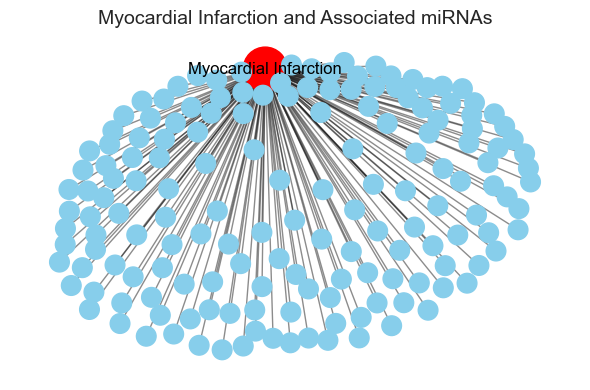

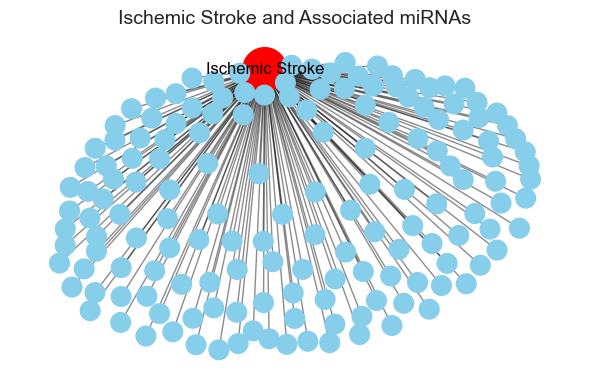

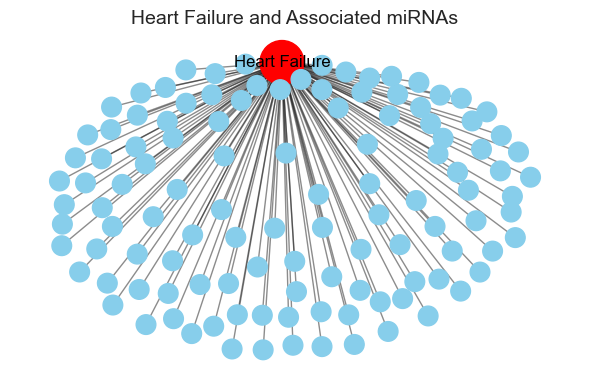

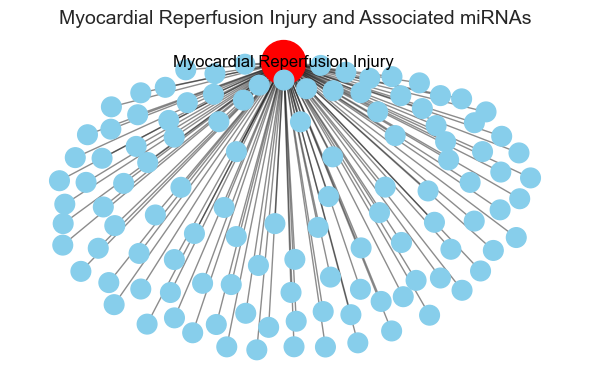

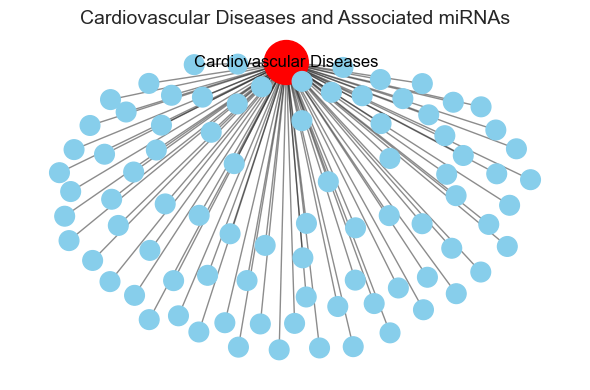

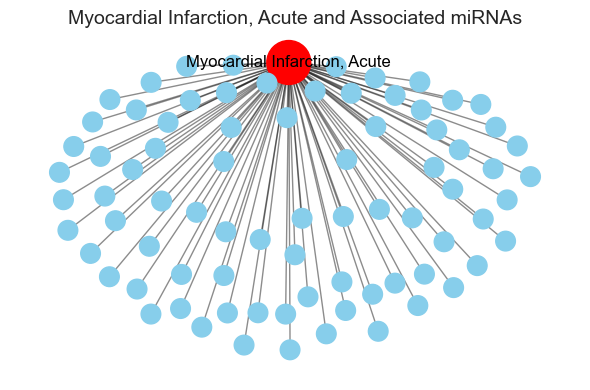

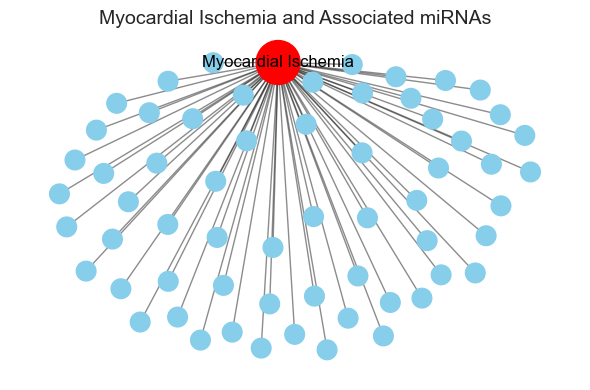

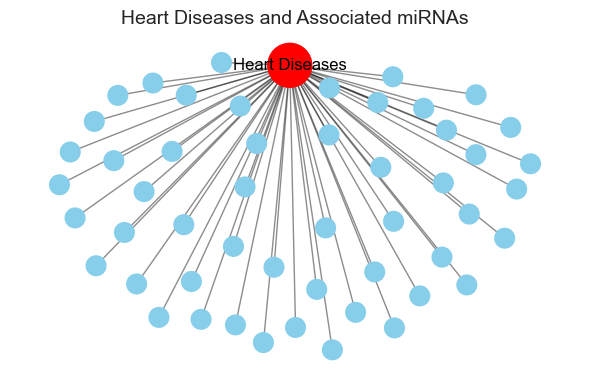

In [70]:
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

# List of top 8 heart diseases
top_diseases = [
    'Myocardial Infarction', 'Ischemic Stroke', 'Heart Failure',
    'Myocardial Reperfusion Injury', 'Cardiovascular Diseases',
    'Myocardial Infarction, Acute', 'Myocardial Ischemia', 'Heart Diseases'
]

# Filter for top diseases only
top_disease_data = filtered[filtered['disease'].isin(top_diseases)]

# Set global style
sns.set(style='white')
plt.rcParams['figure.figsize'] = (6, 4)
plt.rcParams['font.size'] = 10

# Generate and plot graph for each disease
for disease in top_diseases:
    sub_data = top_disease_data[top_disease_data['disease'] == disease]
    miRNAs = sub_data['miRNA'].unique()

    # Build graph
    G = nx.DiGraph()
    G.add_node(disease, color='red', size=1000)
    
    for mirna in miRNAs:
        G.add_node(mirna, color='skyblue', size=200)
        G.add_edge(mirna, disease)

    # Extract styling attributes
    node_colors = [G.nodes[n]['color'] for n in G.nodes()]
    node_sizes = [G.nodes[n]['size'] for n in G.nodes()]

    # Position using spring layout
    pos = nx.spring_layout(G, k=0.5, seed=42)

    # Plot
    plt.figure()
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes)
    nx.draw_networkx_edges(G, pos, arrows=False, alpha=0.5)

    # Only label the disease node
    labels = {n: n for n in G.nodes() if n == disease}
    nx.draw_networkx_labels(G, pos, labels, font_size=12, font_color='black')

    plt.title(f"{disease} and Associated miRNAs", fontsize=14)
    plt.savefig(f"graph_{disease.replace(' ', '_')}.png", dpi=300)
    plt.axis('off')
    plt.tight_layout()
    plt.show()


C:\Users\Basharat Ahmad\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Basharat Ahmad\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


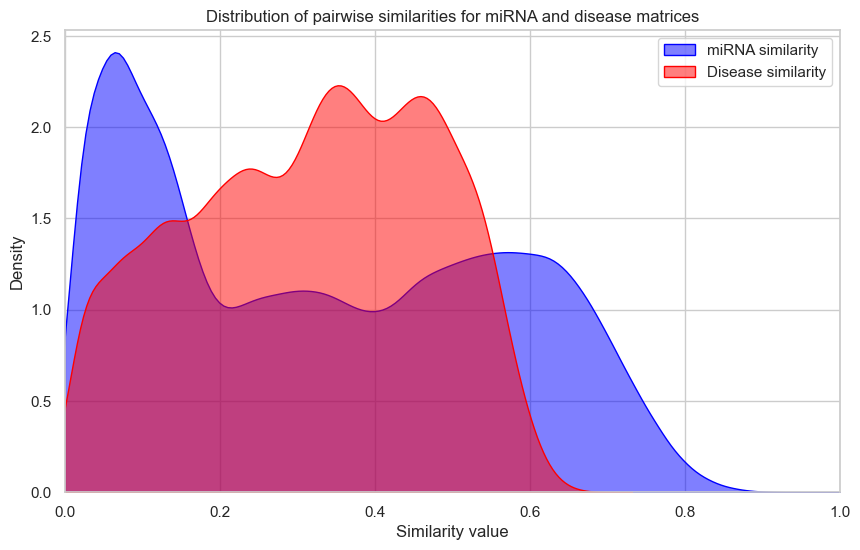

In [74]:
# Create sub_matrix for filtered miRNAs and diseases
sub_matrix = matrix.loc[miRNAs_filtered, diseases_filtered]

# Compute similarities on sub_matrix
miRNA_sim, disease_sim = compute_similarity(sub_matrix)

# Extract upper triangles without diagonal
mirna_upper = miRNA_sim.values[np.triu_indices(miRNA_sim.shape[0], k=1)]
disease_upper = disease_sim.values[np.triu_indices(disease_sim.shape[0], k=1)]

# Plot the distributions
sns.set(style='whitegrid')
plt.figure(figsize=(10,6))
sns.kdeplot(mirna_upper, label='miRNA similarity', color='blue', fill=True, alpha=0.5)
sns.kdeplot(disease_upper, label='Disease similarity', color='red', fill=True, alpha=0.5)
plt.xlim(0,1)
plt.xlabel('Similarity value')
plt.ylabel('Density')
plt.title('Distribution of pairwise similarities for miRNA and disease matrices')
plt.legend()
plt.show()

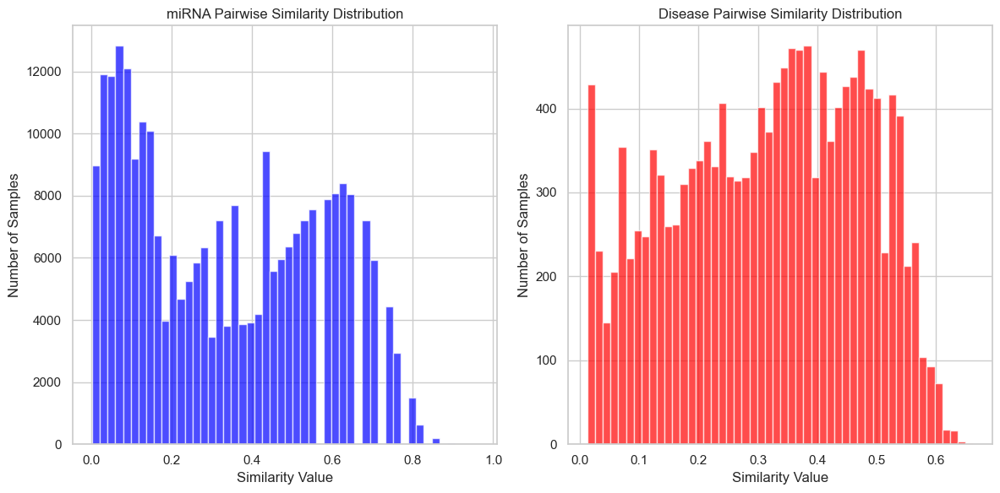

In [75]:
mirna_upper = miRNA_sim.values[np.triu_indices(miRNA_sim.shape[0], k=1)]

# Extract upper triangle without diagonal for disease similarities
disease_upper = disease_sim.values[np.triu_indices(disease_sim.shape[0], k=1)]

# Create figure with two subplots side by side
plt.figure(figsize=(12, 6))

# miRNA histogram (left)
plt.subplot(1, 2, 1)
plt.hist(mirna_upper, bins=50, color='blue', alpha=0.7)
plt.title('miRNA Pairwise Similarity Distribution')
plt.xlabel('Similarity Value')
plt.ylabel('Number of Samples')
plt.grid(True)

# Disease histogram (right)
plt.subplot(1, 2, 2)
plt.hist(disease_upper, bins=50, color='red', alpha=0.7)
plt.title('Disease Pairwise Similarity Distribution')
plt.xlabel('Similarity Value')
plt.ylabel('Number of Samples')
plt.grid(True)

# Adjust layout and display
plt.tight_layout()
plt.show()

In [76]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()


# Select two heart diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'
j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)

# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Compute test_positions for this disease
    test_positions = [pos for pos in test_mask if pos % len(diseases) == disease_idx]
    # Get scores for these positions
    scores = [pred_scores[pos] for pos in test_positions]
    # Sort indices by scores in descending order and take top 10
    sorted_indices = np.argsort(scores)[::-1][:10]
    top_mirnas = []
    for idx in sorted_indices:
        pos = test_positions[idx]
        mirna_idx = pos // len(diseases)
        mirna_symbol = miRNAs[mirna_idx]
        evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
        top_mirnas.append({'miRNA Symbol': mirna_symbol, 'Evidence': evidence})
    return top_mirnas


# Get top miRNAs for both diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)

# Combine into a single table with two sections side by side
table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence']
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1} and {disease2} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

IndexError: index 57 is out of bounds for axis 0 with size 51

In [77]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()

# Select two heart diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'
j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)

# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Get all miRNA indices for this disease
    mirna_indices = list(range(len(MiRNAs)))  # Use len(MiRNAs) instead of n_mirnas if different
    
    # Calculate positions in the flattened prediction array
    # The array is organized as: miRNA0-disease0, miRNA0-disease1, ..., miRNA1-disease0, ...
    test_positions = [miRNA_idx * len(diseases) + disease_idx for miRNA_idx in mirna_indices]
    
    # Get scores for these positions
    scores = [pred_scores[pos] for pos in test_positions if pos < len(pred_scores)]
    
    # Get the corresponding miRNA indices that have valid positions
    valid_mirna_indices = [mirna_indices[i] for i, pos in enumerate(test_positions) if pos < len(pred_scores)]
    
    # Sort by scores in descending order and take top 10
    sorted_indices = np.argsort(scores)[::-1][:10]
    
    top_mirnas = []
    for idx in sorted_indices:
        mirna_idx = valid_mirna_indices[idx]
        mirna_symbol = miRNAs[mirna_idx]  # Make sure this uses the correct variable name (MiRNAs vs miRNAs)
        
        # Calculate the position to check if it's in test_positive_flats
        pos = mirna_idx * len(diseases) + disease_idx
        evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
        
        top_mirnas.append({'miRNA Symbol': mirna_symbol, 'Evidence': evidence})
    
    return top_mirnas

# Get top miRNAs for both diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)

# Combine into a single table with two sections side by side
table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence']
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1} and {disease2} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

NameError: name 'MiRNAs' is not defined

In [78]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()

# Select two heart diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'
j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)

# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Get all miRNA indices for this disease
    # Use n_mirnas if available, otherwise use len(miRNAs)
    if 'n_mirnas' in globals():
        total_mirnas = n_mirnas
    else:
        total_mirnas = len(miRNAs)
    
    mirna_indices = list(range(total_mirnas))
    
    # Calculate positions in the flattened prediction array
    # The array is organized as: miRNA0-disease0, miRNA0-disease1, ..., miRNA1-disease0, ...
    test_positions = [miRNA_idx * len(diseases) + disease_idx for miRNA_idx in mirna_indices]
    
    # Get scores for these positions
    scores = [pred_scores[pos] for pos in test_positions if pos < len(pred_scores)]
    
    # Get the corresponding miRNA indices that have valid positions
    valid_mirna_indices = [mirna_indices[i] for i, pos in enumerate(test_positions) if pos < len(pred_scores)]
    
    # Sort by scores in descending order and take top 10
    sorted_indices = np.argsort(scores)[::-1][:10]
    
    top_mirnas = []
    for idx in sorted_indices:
        mirna_idx = valid_mirna_indices[idx]
        mirna_symbol = miRNAs[mirna_idx]  # Use the correct miRNA list variable
        
        # Calculate the position to check if it's in test_positive_flats
        pos = mirna_idx * len(diseases) + disease_idx
        evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
        
        top_mirnas.append({'miRNA Symbol': mirna_symbol, 'Evidence': evidence})
    
    return top_mirnas

# Get top miRNAs for both diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)

# Combine into a single table with two sections side by side
table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence']
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1} and {disease2} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

IndexError: index 97 is out of bounds for axis 0 with size 51

In [79]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()

# Select two heart diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'
j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)

# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Use the actual miRNA list length to avoid index errors
    total_mirnas = len(miRNAs)  # Use the actual miRNA list size
    
    mirna_indices = list(range(total_mirnas))
    
    # Calculate positions in the flattened prediction array
    # The array is organized as: miRNA0-disease0, miRNA0-disease1, ..., miRNA1-disease0, ...
    test_positions = [miRNA_idx * len(diseases) + disease_idx for miRNA_idx in mirna_indices]
    
    # Filter positions that are within bounds of pred_scores
    valid_positions = [pos for pos in test_positions if pos < len(pred_scores)]
    valid_mirna_indices = [idx for idx in mirna_indices if idx * len(diseases) + disease_idx < len(pred_scores)]
    
    # Get scores for valid positions
    scores = [pred_scores[pos] for pos in valid_positions]
    
    # Sort by scores in descending order and take top 10
    if len(scores) == 0:
        print(f"No valid predictions found for {disease_name}")
        return []
    
    sorted_indices = np.argsort(scores)[::-1][:min(10, len(scores))]
    
    top_mirnas = []
    for idx in sorted_indices:
        mirna_idx = valid_mirna_indices[idx]
        mirna_symbol = miRNAs[mirna_idx]
        
        # Calculate the position to check if it's in test_positive_flats
        pos = mirna_idx * len(diseases) + disease_idx
        evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
        
        top_mirnas.append({'miRNA Symbol': mirna_symbol, 'Evidence': evidence, 'Score': scores[idx]})
    
    return top_mirnas

# Get top miRNAs for both diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)

# Combine into a single table with two sections side by side
# Ensure both DataFrames have the same number of rows by filling with NaN if necessary
max_rows = max(len(df_D1), len(df_D2))
df_D1 = df_D1.reindex(range(max_rows))
df_D2 = df_D2.reindex(range(max_rows))

table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence']
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1} and {disease2} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

The top 10 miRNA predictions associated with Myocardial Infarction and Ischemic Stroke as obtained by the model, confirmed via the dataset.
Myocardial Infarction miRNA Symbol Myocardial Infarction Evidence Ischemic Stroke miRNA Symbol Ischemic Stroke Evidence
                       hsa-mir-155                    Unconfirmed                  hsa-mir-155                Confirmed
                       hsa-mir-15b                    Unconfirmed                  hsa-mir-731              Unconfirmed
                      hsa-mir-135a                    Unconfirmed                 hsa-mir-146a              Unconfirmed
                      hsa-mir-146a                    Unconfirmed                  hsa-mir-29b              Unconfirmed
                       hsa-mir-214                    Unconfirmed                    hsa-mir-1                Confirmed
                       hsa-mir-375                    Unconfirmed                   hsa-mir-22                Confirmed
                    

In [80]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()

# Select two heart diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'
j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)

# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Determine the safe range of miRNA indices
    # Use the minimum of actual miRNA list size and n_mirnas
    safe_total_mirnas = min(len(miRNAs), n_mirnas)
    
    mirna_indices = list(range(safe_total_mirnas))
    
    # Calculate positions and filter valid ones
    valid_data = []
    for mirna_idx in mirna_indices:
        pos = mirna_idx * len(diseases) + disease_idx
        if pos < len(pred_scores):
            score = pred_scores[pos]
            mirna_symbol = miRNAs[mirna_idx]
            evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
            valid_data.append({
                'mirna_idx': mirna_idx,
                'mirna_symbol': mirna_symbol,
                'score': score,
                'evidence': evidence
            })
    
    # Sort by score in descending order and take top 10
    valid_data.sort(key=lambda x: x['score'], reverse=True)
    top_data = valid_data[:10]
    
    top_mirnas = []
    for item in top_data:
        top_mirnas.append({
            'miRNA Symbol': item['mirna_symbol'],
            'Evidence': item['evidence'],
            'Score': item['score']
        })
    
    print(f"Found {len(top_data)} valid predictions for {disease_name}")
    return top_mirnas

# Get top miRNAs for both diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)

# Combine into a single table
max_rows = max(len(df_D1), len(df_D2))
df_D1 = df_D1.reindex(range(max_rows))
df_D2 = df_D2.reindex(range(max_rows))

table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence']
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"\nThe top miRNA predictions associated with {disease1} and {disease2} as obtained by the model:")
print(combined_df.to_string(index=False))

Found 10 valid predictions for Myocardial Infarction
Found 10 valid predictions for Ischemic Stroke

The top miRNA predictions associated with Myocardial Infarction and Ischemic Stroke as obtained by the model:
Myocardial Infarction miRNA Symbol Myocardial Infarction Evidence Ischemic Stroke miRNA Symbol Ischemic Stroke Evidence
                       hsa-mir-155                    Unconfirmed                  hsa-mir-155                Confirmed
                       hsa-mir-15b                    Unconfirmed                  hsa-mir-731              Unconfirmed
                      hsa-mir-135a                    Unconfirmed                 hsa-mir-146a              Unconfirmed
                      hsa-mir-146a                    Unconfirmed                  hsa-mir-29b              Unconfirmed
                       hsa-mir-214                    Unconfirmed                    hsa-mir-1                Confirmed
                       hsa-mir-375                    Unconfirmed    

## Adding cancer 

In [90]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()


# Select two heart diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'

j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)

# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Compute test_positions for this disease
    test_positions = [pos for pos in test_mask if pos % len(diseases) == disease_idx]
    # Get scores for these positions
    scores = [pred_scores[pos] for pos in test_positions]
    # Sort indices by scores in descending order and take top 10
    sorted_indices = np.argsort(scores)[::-1][:10]
    top_mirnas = []
    for idx in sorted_indices:
        pos = test_positions[idx]
        mirna_idx = pos // len(diseases)
        mirna_symbol = miRNAs[mirna_idx]
        evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
        top_mirnas.append({'miRNA Symbol': mirna_symbol, 'Evidence': evidence})
    return top_mirnas


# Get top miRNAs for both diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)

# Combine into a single table with two sections side by side
table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence']
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1} and {disease2} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

The top 10 miRNA predictions associated with Myocardial Infarction and Ischemic Stroke as obtained by the model, confirmed via the dataset.
Myocardial Infarction miRNA Symbol Myocardial Infarction Evidence Ischemic Stroke miRNA Symbol Ischemic Stroke Evidence
                       hsa-mir-29a                      Confirmed                   hsa-mir-21                Confirmed
                       hsa-mir-29b                      Confirmed                  hsa-mir-29b                Confirmed
                       hsa-mir-195                      Confirmed                  hsa-mir-126                Confirmed
                       hsa-mir-143                      Confirmed                  hsa-mir-34a                Confirmed
                       hsa-mir-223                      Confirmed                 hsa-mir-125a                Confirmed
                       hsa-mir-144                      Confirmed                  hsa-mir-206                Confirmed
                    

In [91]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()
# Select diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'
disease3 = 'Cancer Pain'  # New cancer disease
j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)
j_D3 = list(diseases).index(disease3)

# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Determine the safe range of miRNA indices
    safe_total_mirnas = min(len(miRNAs), n_mirnas)
    
    mirna_indices = list(range(safe_total_mirnas))
    
    # Calculate positions and filter valid ones
    valid_data = []
    for mirna_idx in mirna_indices:
        pos = mirna_idx * len(diseases) + disease_idx
        if pos < len(pred_scores):
            score = pred_scores[pos]
            mirna_symbol = miRNAs[mirna_idx]
            evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
            valid_data.append({
                'mirna_idx': mirna_idx,
                'mirna_symbol': mirna_symbol,
                'score': score,
                'evidence': evidence
            })
    
    # Sort by score in descending order and take top 10
    valid_data.sort(key=lambda x: x['score'], reverse=True)
    top_data = valid_data[:10]
    
    top_mirnas = []
    for item in top_data:
        top_mirnas.append({
            'miRNA Symbol': item['mirna_symbol'],
            'Evidence': item['evidence']
        })
    
    print(f"Found {len(top_data)} valid predictions for {disease_name}")
    return top_mirnas

# Get top miRNAs for all diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)
top_mirnas_D3 = get_top_mirnas(j_D3, disease3)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)
df_D3 = pd.DataFrame(top_mirnas_D3)

# Combine into a single table with the new cancer columns added
max_rows = max(len(df_D1), len(df_D2), len(df_D3))
df_D1 = df_D1.reindex(range(max_rows))
df_D2 = df_D2.reindex(range(max_rows))
df_D3 = df_D3.reindex(range(max_rows))

table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence'],
    f'{disease3} miRNA Symbol': df_D3['miRNA Symbol'],  # New cancer columns
    f'{disease3} Evidence': df_D3['Evidence']           # New cancer columns
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1}, {disease2}, and {disease3} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

Found 10 valid predictions for Myocardial Infarction
Found 10 valid predictions for Ischemic Stroke
Found 10 valid predictions for Cancer Pain
The top 10 miRNA predictions associated with Myocardial Infarction, Ischemic Stroke, and Cancer Pain as obtained by the model, confirmed via the dataset.
Myocardial Infarction miRNA Symbol Myocardial Infarction Evidence Ischemic Stroke miRNA Symbol Ischemic Stroke Evidence Cancer Pain miRNA Symbol Cancer Pain Evidence
                        hsa-mir-21                    Unconfirmed                   hsa-mir-21                Confirmed               hsa-mir-17          Unconfirmed
                        hsa-mir-17                    Unconfirmed                  hsa-mir-29a              Unconfirmed              hsa-mir-34a          Unconfirmed
                       hsa-mir-145                    Unconfirmed                  hsa-mir-155              Unconfirmed               hsa-mir-21          Unconfirmed
                       hsa-mir-27a     

In [95]:
combined_df

,Myocardial Infarction miRNA Symbol,Myocardial Infarction Evidence,Ischemic Stroke miRNA Symbol,Ischemic Stroke Evidence,Cancer Pain miRNA Symbol,Cancer Pain Evidence
0,hsa-mir-21,Unconfirmed,hsa-mir-21,Confirmed,hsa-mir-17,Unconfirmed
1,hsa-mir-17,Unconfirmed,hsa-mir-29a,Unconfirmed,hsa-mir-34a,Unconfirmed
2,hsa-mir-145,Unconfirmed,hsa-mir-155,Unconfirmed,hsa-mir-21,Unconfirmed
3,hsa-mir-27a,Unconfirmed,hsa-mir-146a,Unconfirmed,hsa-mir-137,Unconfirmed
4,hsa-mir-155,Unconfirmed,hsa-mir-24,Unconfirmed,hsa-mir-141,Unconfirmed
5,hsa-mir-34a,Unconfirmed,hsa-mir-1,Unconfirmed,hsa-mir-214,Unconfirmed
6,hsa-mir-20a,Unconfirmed,hsa-mir-29b,Confirmed,hsa-mir-27a,Unconfirmed
7,hsa-mir-142,Unconfirmed,hsa-mir-126,Confirmed,hsa-mir-451a,Unconfirmed
8,hsa-mir-125b,Unconfirmed,hsa-mir-145,Unconfirmed,hsa-mir-16,Unconfirmed
9,hsa-mir-24,Unconfirmed,hsa-mir-210,Unconfirmed,hsa-mir-23a,Unconfirmed


In [96]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()
# Select diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'
j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)
# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Determine the safe range of miRNA indices
    safe_total_mirnas = min(len(miRNAs), n_mirnas)
    
    mirna_indices = list(range(safe_total_mirnas))
    
    # Calculate positions and filter valid ones
    valid_data = []
    for mirna_idx in mirna_indices:
        pos = mirna_idx * len(diseases) + disease_idx
        if pos < len(pred_scores):
            score = pred_scores[pos]
            mirna_symbol = miRNAs[mirna_idx]
            evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
            valid_data.append({
                'mirna_idx': mirna_idx,
                'mirna_symbol': mirna_symbol,
                'score': score,
                'evidence': evidence
            })
    
    # Sort by score in descending order and take top 10
    valid_data.sort(key=lambda x: x['score'], reverse=True)
    top_data = valid_data[:10]
    
    top_mirnas = []
    for item in top_data:
        top_mirnas.append({
            'miRNA Symbol': item['mirna_symbol'],
            'Evidence': item['evidence']
        })
    
    print(f"Found {len(top_data)} valid predictions for {disease_name}")
    return top_mirnas

# Get top miRNAs for all diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)
# Combine into a single table with the new cancer columns added
max_rows = max(len(df_D1), len(df_D2),len(df_D3))
df_D1 = df_D1.reindex(range(max_rows))
df_D2 = df_D2.reindex(range(max_rows))
df_D3 = df_D3.reindex(range(max_rows))

table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence'],
     f'{disease3} miRNA Symbol': df_D3['miRNA Symbol'],
    f'{disease3} Evidence': df_D3['Evidence'],
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1}, {disease2}, and {disease3} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

Found 10 valid predictions for Myocardial Infarction
Found 10 valid predictions for Ischemic Stroke
The top 10 miRNA predictions associated with Myocardial Infarction, Ischemic Stroke, and Cancer Pain as obtained by the model, confirmed via the dataset.
Myocardial Infarction miRNA Symbol Myocardial Infarction Evidence Ischemic Stroke miRNA Symbol Ischemic Stroke Evidence
                        hsa-mir-21                    Unconfirmed                   hsa-mir-21                Confirmed
                        hsa-mir-17                    Unconfirmed                  hsa-mir-29a              Unconfirmed
                       hsa-mir-145                    Unconfirmed                  hsa-mir-155              Unconfirmed
                       hsa-mir-27a                    Unconfirmed                 hsa-mir-146a              Unconfirmed
                       hsa-mir-155                    Unconfirmed                   hsa-mir-24              Unconfirmed
                       hsa

In [97]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()


# Select two heart diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'

j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)

# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Compute test_positions for this disease
    test_positions = [pos for pos in test_mask if pos % len(diseases) == disease_idx]
    # Get scores for these positions
    scores = [pred_scores[pos] for pos in test_positions]
    # Sort indices by scores in descending order and take top 10
    sorted_indices = np.argsort(scores)[::-1][:10]
    top_mirnas = []
    for idx in sorted_indices:
        pos = test_positions[idx]
        mirna_idx = pos // len(diseases)
        mirna_symbol = miRNAs[mirna_idx]
        evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
        top_mirnas.append({'miRNA Symbol': mirna_symbol, 'Evidence': evidence})
    return top_mirnas


# Get top miRNAs for both diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)

# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)

# Combine into a single table with two sections side by side
table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence']
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1} and {disease2} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

The top 10 miRNA predictions associated with Myocardial Infarction and Ischemic Stroke as obtained by the model, confirmed via the dataset.
Myocardial Infarction miRNA Symbol Myocardial Infarction Evidence Ischemic Stroke miRNA Symbol Ischemic Stroke Evidence
                       hsa-mir-29a                      Confirmed                   hsa-mir-21                Confirmed
                       hsa-mir-29b                      Confirmed                  hsa-mir-29b                Confirmed
                       hsa-mir-195                      Confirmed                  hsa-mir-126                Confirmed
                       hsa-mir-143                      Confirmed                  hsa-mir-34a                Confirmed
                       hsa-mir-223                      Confirmed                 hsa-mir-125a                Confirmed
                       hsa-mir-144                      Confirmed                  hsa-mir-206                Confirmed
                    

In [111]:
import pandas as pd
import numpy as np
import torch

# Compute predictions for all pairs
with torch.no_grad():
    out = model_loaded(gcn_data_final)
    mirna_emb, disease_emb = out[:n_mirnas], out[n_mirnas:]
    pred = (mirna_emb @ disease_emb.t()).view(-1)
    pred_scores = torch.sigmoid(pred).cpu().numpy()


# Select two heart diseases
disease1 = 'Myocardial Infarction'
disease2 = 'Ischemic Stroke'
disease3 = 'Lung Neoplasms'  # New cancer disease
disease4 = 'Breast Neoplasms' # Breast Neoplasms
disease5 = 'Fibrosis' # fibrosis
j_D1 = list(diseases).index(disease1)
j_D2 = list(diseases).index(disease2)
j_D3 = list(diseases).index(disease3)
j_D4 = list(diseases).index(disease4)
j_D5 = list(diseases).index(disease5)
# Function to get top 10 miRNAs for a disease
def get_top_mirnas(disease_idx, disease_name):
    # Compute test_positions for this disease
    test_positions = [pos for pos in test_mask if pos % len(diseases) == disease_idx]
    # Get scores for these positions
    scores = [pred_scores[pos] for pos in test_positions]
    # Sort indices by scores in descending order and take top 10
    sorted_indices = np.argsort(scores)[::-1][:10]
    top_mirnas = []
    for idx in sorted_indices:
        pos = test_positions[idx]
        mirna_idx = pos // len(diseases)
        mirna_symbol = miRNAs[mirna_idx]
        evidence = 'Confirmed' if pos in test_positive_flats else 'Unconfirmed'
        top_mirnas.append({'miRNA Symbol': mirna_symbol, 'Evidence': evidence})
    return top_mirnas


# Get top miRNAs for both diseases
top_mirnas_D1 = get_top_mirnas(j_D1, disease1)
top_mirnas_D2 = get_top_mirnas(j_D2, disease2)
top_mirnas_D3 = get_top_mirnas(j_D3, disease3)
top_mirnas_D4 = get_top_mirnas(j_D4, disease4)
top_mirnas_D5 = get_top_mirnas(j_D5, disease5)
# Create DataFrames
df_D1 = pd.DataFrame(top_mirnas_D1)
df_D2 = pd.DataFrame(top_mirnas_D2)
df_D3 = pd.DataFrame(top_mirnas_D3)
df_D4 = pd.DataFrame(top_mirnas_D4)
df_D5 = pd.DataFrame(top_mirnas_D5)
# Combine into a single table with two sections side by side
table_data = {
    f'{disease1} miRNA Symbol': df_D1['miRNA Symbol'],
    f'{disease1} Evidence': df_D1['Evidence'],
    f'{disease2} miRNA Symbol': df_D2['miRNA Symbol'],
    f'{disease2} Evidence': df_D2['Evidence'],
     f'{disease3} miRNA Symbol': df_D3['miRNA Symbol'],
    f'{disease3} Evidence': df_D3['Evidence'],
    f'{disease4} miRNA Symbol': df_D4['miRNA Symbol'],
    f'{disease4} Evidence': df_D4['Evidence'],
    f'{disease5} miRNA Symbol': df_D5['miRNA Symbol'],
    f'{disease5} Evidence': df_D5['Evidence'],
    
    
}
combined_df = pd.DataFrame(table_data)

# Display the table
print(f"The top 10 miRNA predictions associated with {disease1} and {disease2} as obtained by the model, confirmed via the dataset.")
print(combined_df.to_string(index=False))

The top 10 miRNA predictions associated with Myocardial Infarction and Ischemic Stroke as obtained by the model, confirmed via the dataset.
Myocardial Infarction miRNA Symbol Myocardial Infarction Evidence Ischemic Stroke miRNA Symbol Ischemic Stroke Evidence Lung Neoplasms miRNA Symbol Lung Neoplasms Evidence Breast Neoplasms miRNA Symbol Breast Neoplasms Evidence Fibrosis miRNA Symbol Fibrosis Evidence
                       hsa-mir-29a                      Confirmed                   hsa-mir-21                Confirmed                 hsa-mir-23a               Confirmed                  hsa-mir-146a                 Confirmed           hsa-mir-29b         Confirmed
                       hsa-mir-29b                      Confirmed                  hsa-mir-29b                Confirmed                 hsa-mir-29b               Confirmed                   hsa-mir-23a                 Confirmed           hsa-mir-150         Confirmed
                       hsa-mir-195                      

In [112]:
combined_df

,Myocardial Infarction miRNA Symbol,Myocardial Infarction Evidence,Ischemic Stroke miRNA Symbol,Ischemic Stroke Evidence,Lung Neoplasms miRNA Symbol,Lung Neoplasms Evidence,Breast Neoplasms miRNA Symbol,Breast Neoplasms Evidence,Fibrosis miRNA Symbol,Fibrosis Evidence
0,hsa-mir-29a,Confirmed,hsa-mir-21,Confirmed,hsa-mir-23a,Confirmed,hsa-mir-146a,Confirmed,hsa-mir-29b,Confirmed
1,hsa-mir-29b,Confirmed,hsa-mir-29b,Confirmed,hsa-mir-29b,Confirmed,hsa-mir-23a,Confirmed,hsa-mir-150,Confirmed
2,hsa-mir-195,Confirmed,hsa-mir-126,Confirmed,hsa-mir-27b,Confirmed,hsa-mir-24,Confirmed,hsa-mir-375,Confirmed
3,hsa-mir-143,Confirmed,hsa-mir-34a,Confirmed,hsa-mir-22,Confirmed,hsa-mir-205,Confirmed,hsa-mir-29,Confirmed
4,hsa-mir-223,Confirmed,hsa-mir-125a,Confirmed,hsa-mir-375,Confirmed,hsa-mir-23b,Confirmed,hsa-mir-451,Confirmed
5,hsa-mir-144,Confirmed,hsa-mir-206,Confirmed,hsa-mir-126,Confirmed,hsa-mir-192,Confirmed,hsa-mir-200a,Confirmed
6,hsa-mir-15b,Confirmed,hsa-mir-146b,Confirmed,hsa-mir-101,Confirmed,hsa-mir-210,Confirmed,hsa-mir-122,Confirmed
7,hsa-mir-214,Confirmed,hsa-mir-204,Confirmed,hsa-mir-641,Confirmed,hsa-mir-138,Confirmed,hsa-mir-29b-1,Confirmed
8,hsa-mir-218,Confirmed,hsa-mir-9,Confirmed,hsa-mir-340,Confirmed,hsa-mir-146b,Confirmed,hsa-mir-374a,Confirmed
9,hsa-mir-7,Confirmed,hsa-mir-19a,Confirmed,hsa-mir-152,Confirmed,hsa-mir-556,Confirmed,hsa-mir-1202,Confirmed


In [114]:
combined_df.to_csv('combined1_data.csv', index=False)

In [ ]:
import os
print(getcwd)